
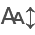

In [5]:
from __future__ import print_function, division
import mdtraj as md

import os
import sys
import numpy as np
from numpy import mean
import scipy as sp
from scipy import optimize
from scipy.optimize import leastsq
import matplotlib
import matplotlib.pyplot as plt
from matplotlib import colors
# import seaborn as sns
import math
import itertools    
from numpy import log2, zeros, mean, var, sum, loadtxt, arange, array, cumsum, dot, transpose, diagonal, floor
from numpy.linalg import inv, lstsq
import pyblock

import itables

from itables import init_notebook_mode
init_notebook_mode(all_interactive=True)

from scipy.stats import pearsonr
import json


class NpEncoder(json.JSONEncoder):
    def default(self, obj):
        if isinstance(obj, np.integer):
            return int(obj)
        if isinstance(obj, np.floating):
            return float(obj)
        if isinstance(obj, np.ndarray):
            return obj.tolist()
        return json.JSONEncoder.default(self, obj)

if '/home/jayakrishna/work/scripts/analysis_class/' in sys.path:
    sys.path.remove('/home/jayakrishna/work/scripts/analysis_class/')

sys.path.insert(0, '/home/jayakrishna/work/scripts/analysis_class/')

from importlib import *

from Block_analysis import *

import small_utilities
reload(small_utilities)
from small_utilities import *

from scipy.stats import bootstrap

In [6]:
def free_energy_2D_blockerror(Y, X, bins=None, T:int=None, y0:float=None, ymax:float=None, x0:float=None,
                   xmax:float=None, weights=None, blocks=10):
    
    histo, xedges, yedges = np.histogram2d(
        Y, X, bins, [[y0, ymax], [x0, xmax]], density=True, weights=weights
    )
    # max = np.max(histo)
    # free_energy=-(0.001987*T)*np.log(histo)
    free_energy = -(0.001987*T)*np.log(np.flipud(histo)+.000001)
    free_energy = free_energy-np.min(free_energy)

    xcenters = xedges[:-1] + np.diff(xedges)/2
    ycenters = yedges[:-1] + np.diff(yedges)/2

    Ind = chunkIt(len(Y), blocks)
    block_size = (Ind[0][1]-Ind[0][0])
    hist_blocks = []
    # for i in range(0, len(Ind)):
    for i in np.arange(0, blocks):

        block_data_Y = Y[Ind[i][0]:Ind[i][1]]
        block_data_X = X[Ind[i][0]:Ind[i][1]]

        if weights is not None: block_weights = weights[Ind[i][0]:Ind[i][1]]
        else: block_weights = None

        hist, xedges, yedges = np.histogram2d(
            block_data_Y, block_data_X, bins, [[y0, ymax], [x0, xmax]], density=True, weights=block_weights
        )
        # hist, binedges = np.histogram(block_data, bins=bins, range=[
        #                             x0, xmax], density=True, weights=weights[Ind[i][0]:Ind[i][1]])
        hist_blocks.append(hist)
        
    hist_blocks = np.array(hist_blocks)
    average = np.average(hist_blocks, axis=0)
    variance = np.var(hist_blocks, axis=0)
    N = len(hist_blocks)
    error = np.sqrt(variance / N)
    ferr = -(0.001987*T)*(error / average)

    return free_energy, xcenters, ycenters, ferr, error

def adjust_min(x):
    idx = (x == 0)
    x[idx] = x[~idx].min()
    return x

def blocking_2d_hist(Y, X, y0:float=None, ymax:float=None, x0:float=None,
                   xmax:float=None, weights=None, chunk_width=10, bin_count=35):
    """blocking_2d_hist used to produce individual 2D histograms of chunk_width
    blocks of data. The width needs to be identified from reblocking analysis of
    each 2D variable. Bin count is up to you, but should be the same for all."""
    
    import numpy as np
    from Block_analysis import chunkIt

    assert len(Y) == len(X), "Y and X must have the same length"
    chunks = chunkIt(len(Y), chunk_width)
    bounds=np.array([[y0, ymax], [x0, xmax]]) + np.array([[-0.01, 0.01], [-0.01, 0.01]])
    bins = [np.linspace(bounds[0][0], bounds[0][1], bin_count+1),
            np.linspace(bounds[1][0], bounds[1][1], bin_count+1)]
    flattened_histos = np.zeros((bin_count**2,len(chunks)))

    for i, chunk in enumerate(chunks):
        histo, _, _ = np.histogram2d(
                            Y[chunk[0]:chunk[1]], 
                            X[chunk[0]:chunk[1]], 
                            bins, 
                            bounds, 
                            density=False, 
                            weights=weights[chunk[0]:chunk[1]] if weights is not None else None
                            )   
        flattened_histos[:, i] = histo.flatten()
    xcenters = (bins[0][1:]+bins[0][:-1])/2
    ycenters = (bins[1][1:]+bins[1][:-1])/2

    return flattened_histos/chunk_width, xcenters, ycenters

def blocking_bootstrap_2d_fe(X, Y, bin_count,y0, ymax, x0, xmax,weights=None):

    import numpy as np
    import pyblock as pb
    from scipy.stats import bootstrap

    assert len(Y) == len(X), "Y and X must have the same length"

    if not isinstance(X, np.ndarray):
        X = np.array(X)
    if not isinstance(Y, np.ndarray):
        Y = np.array(Y)

    
    reblock_data_X = pb.blocking.reblock(X, weights=weights)
    reblock_data_Y = pb.blocking.reblock(Y, weights=weights)

    opt_X = pb.blocking.find_optimal_block(
        len(X), reblock_data_X)[0]
    opt_Y = pb.blocking.find_optimal_block(
        len(Y), reblock_data_Y)[0]

    # print(opt_X, opt_Y)
    # block_length = reblock_data_X[opt_X].ndata if \
    #             reblock_data_X[opt_X].ndata > reblock_data_X[opt_Y].ndata \
    #                     else reblock_data_Y[opt_Y].ndata


    # print('Optimal block size for X:', reblock_data_X[opt_X].ndata)
    # print('Optimal block size for Y:', reblock_data_Y[opt_Y].ndata)

    # block_length = input("Enter the desired block length: ")
    # block_length = int(block_length)
    # if block_length <= 0:
    #     raise ValueError("Block length must be a positive integer.")
    block_length = reblock_data_X[opt_X].ndata if \
                reblock_data_X[opt_X].ndata > reblock_data_Y[opt_Y].ndata \
                        else reblock_data_Y[opt_Y].ndata
    
    skip = len(X) % block_length
    
    # print('Block length:', block_length)
    # print('Skip:', skip)

    options = {'Y':Y[skip:], 'X':X[skip:], 'y0':y0, 'ymax':ymax, 'x0':x0, 'xmax':xmax, 
                'chunk_width':block_length, 'bin_count':bin_count, 'weights': weights,}

    hist_2d_for_fe, xcenters, ycenters = blocking_2d_hist(**options)

    def fe2D(x): 
        p = np.sum(x, axis=-1)/len(x)
        fe = -(0.001987*300)*np.log(p+0.000000001)
        return fe

    bootstrap_results = bootstrap((hist_2d_for_fe.T,), fe2D, n_resamples=1000, method='percentile')

    return bootstrap_results, xcenters, ycenters

## Loading the data

In [7]:
sequence=  ['ASP121', 'ASN122', 'GLU123', 'ALA124', 'TYR125', 'GLU126', 'MET127', 'PRO128', 'SER129', 'GLU130', 'GLU131', 'GLY132', 'TYR133', 'GLN134', 'ASP135',
'TYR136', 'GLU137', 'PRO138', 'GLU139', 'ALA140']

aa_dict = {'ALA' : ["A", "Alanine"], 'ARG' : ["R", "Arginine"], 'ASN' : ["N", "Asparagine"], 'ASP' : ["D", "Aspartic-acid"], 'CYS' : ["C", "Cysteine"], 
           'GLU' : ["E", "Glutamic-acid"], 'GLN' : ["Q", "Glutamine"], 'GLY' : ["G", "Glycine"], 'HIS' : ["H", "Histidine"], 'ILE' : ["I", "Isoleucine"],
           'LEU' : ["L", "Leucine"], 'LYS' : ["K", "Lysine"], 'MET' : ["M", "Methionine"], 'PHE' : ["F", "Phenylalanine"], 'PRO' : ["P", "Proline"], 
           'SER' : ["S", "Serine"], 'THR' : ["T", "Threonine"], 'TRP' : ["W", "Truptophan"], 'TYR' : ["Y", "Tyrosine"], 'VAL' : ["V", "Valine"]}

w_dir='/data/jk_ssREST3_repo_data/data/'
meta_dir=f'{w_dir}/PBMetaD/'

data_dir=np.array([ f'{w_dir}/REST2/data_apo_20/',
f'{w_dir}/REST2/data_apo_10/',
f'{w_dir}/ssREST3/data_apo_16/',
f'{w_dir}/ssREST3/data_apo_8/',])

title_={ 0 :'REST2 (20 reps)', 1 :'REST2 (10 reps)', 2 :'ssREST3 (16 reps)', 3 :'ssREST3 (8 reps)',
         4 : 'PBMetaD-1 (16 reps)', 5 : 'PBMetaD-2 (16 reps)' }
nrep=[20,10,16,8,16,16]

print(data_dir)

# out_dir = f'{w_dir}/plots_now/plots/apo/'

out_dir='./comparision_plots/'
make_dir(out_dir)

color_options = ['darkred', 'coral', 'green', 'chartreuse', 'blue', 'dodgerblue']
# color_options=['coral', 'darkred', 'lightgreen', 'green', 'blue', 'dodgerblue'] # 'mediumspringgreen'



['/data/jk_ssREST3_repo_data/data//REST2/data_apo_20/'
 '/data/jk_ssREST3_repo_data/data//REST2/data_apo_10/'
 '/data/jk_ssREST3_repo_data/data//ssREST3/data_apo_16/'
 '/data/jk_ssREST3_repo_data/data//ssREST3/data_apo_8/']


In [8]:
temperature={}

temperature[0] = compute_temperatures((300, 600), 20)
temperature[1] = compute_temperatures((300, 450), 10)
temperature[2] = compute_temperatures((300, 450), 16)
temperature[3] = compute_temperatures((300, 450), 8)

In [9]:
# Data directories for the Apo, Fas and Lig47 systems respectively

# w_dir='/Volumes/128JK/work/REST_DATA/'

data_dir_a=np.array([ f'{w_dir}/REST2/data_apo_20/',
f'{w_dir}/REST2/data_apo_10/',
f'{w_dir}/ssREST3/data_apo_16/',
f'{w_dir}/ssREST3/data_apo_8/',
f'{meta_dir}/apo_1/',
f'{meta_dir}/apo_2/'])

data_dir_f=np.array([ f'{w_dir}/REST2/data_fas_20/',
f'{w_dir}/REST2/data_fas_10/',
f'{w_dir}/ssREST3/data_fas_16/',
f'{w_dir}/ssREST3/data_fas_8/',
f'{meta_dir}/fas_1/data/out_0/',
f'{meta_dir}/fas_2/data/out_0/'])

data_dir_l=np.array([ f'{w_dir}/REST2/data_lig47_20/',
f'{w_dir}/REST2/data_lig47_10/',
f'{w_dir}/ssREST3/data_lig47_16/',
f'{w_dir}/ssREST3/data_lig47_8/',
f'{meta_dir}/lig47_1/data/out_0/',
f'{meta_dir}/lig47_2/data/out_0/'])

In [10]:
ticks_pnum , ticks_pname = sequence_ticks_1(sequence)

In [11]:
print('Meta-Dynamics Weights')
weights_norm={}
colvar={}

file_1=f'{meta_dir}/apo_1/colvar.dat'
file_2=f'{meta_dir}/apo_2/colvar.dat'

num_cvs_1, weights_1, weights_norm['combined_1'] = norm_weights(file_1)
num_cvs_2, weights_2, weights_norm['combined_2'] = norm_weights(file_2)

print("No of CV's :", (num_cvs_1-1,num_cvs_2-1))
print(f"Sum of combined xtc : {np.sum(weights_norm['combined_1'])} , {np.sum(weights_norm['combined_2'])}")

colvar['combined_1']=np.loadtxt(file_1,comments=['@','#'])
colvar['combined_2']=np.loadtxt(file_2,comments=['@','#'])

Meta-Dynamics Weights
No of CV's : (6, 6)
Sum of combined xtc : 1.0000000000000002 , 0.9999999999999997


In [ ]:
rg_pb1, rg_pb1_e=get_blockerror_pyblock_nanskip_rw_(colvar['combined_1'].T[1], weights=weights_norm['combined_1'])
rg_pb2, rg_pb2_e=get_blockerror_pyblock_nanskip_rw_(colvar['combined_2'].T[1], weights=weights_norm['combined_2'])


In [ ]:
rg={}

p=0
for i in data_dir:
    
    rg[p]=json.load(open(i+'rg.json','r'))
    
    p+=1

## Converting and creating an array of mean $R_{g}$

In [ ]:
mean_list=[]

# for val in range(len(data_dir)-2):
for val in range(len(data_dir)):
    a=[]
    for i in range(nrep[val]):

        a.append(get_blockerror_pyblock_nanskip(np.array(rg[val][f'rep:{i}'])))

    mean_list.append(np.array(a))

mean_list=np.array(mean_list, dtype=object)


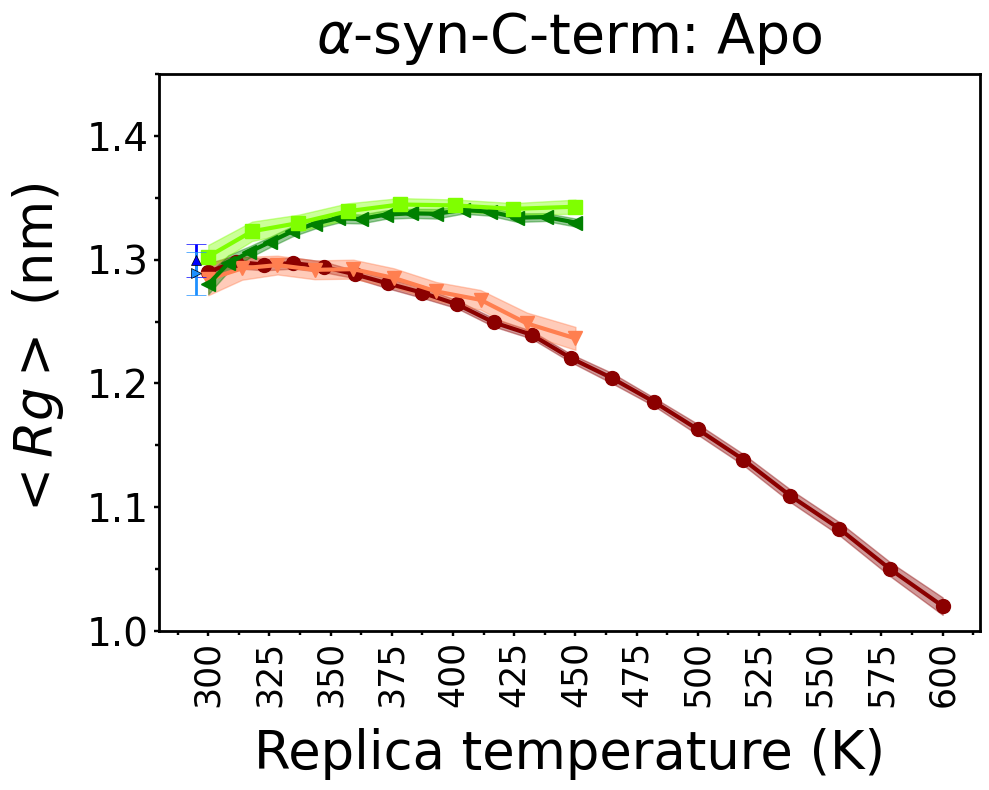

In [ ]:
marker=['o','v','<', 's','^','>']
# color=['black', 'red', 'blue', 'green']
color_options = ['darkred', 'coral', 'green', 'chartreuse', 'blue', 'dodgerblue']

plt.figure(figsize=(10,8))


c=['combined_1','combined_2']
# rg_pb1, rg_pb1_e



for val in range(len(data_dir)):
    
    # plt.errorbar(temperature[val], mean_list[val].T[0], yerr=mean_list[val].T[1],fmt=marker[val], color=color_options[val], label=title_[val], elinewidth=2, capsize=7, mec='black', mew=0.5, ms=6.8)
    plt.plot(temperature[val], mean_list[val].T[0], color=color_options[val], label=title_[val], linewidth=3, marker=marker[val], markersize=10)
    plt.fill_between(temperature[val], mean_list[val].T[0]-mean_list[val].T[1], mean_list[val].T[0]+mean_list[val].T[1], color=color_options[val], alpha=0.4)


plt.errorbar(temperature[0][0]-5, rg_pb1, yerr=rg_pb1_e,fmt=marker[4], color=color_options[4], label=title_[4], elinewidth=2, capsize=7, mec='black', mew=0.5, ms=6.8)
plt.errorbar(temperature[0][0]-5, rg_pb2, yerr=rg_pb2_e,fmt=marker[5], color=color_options[5], label=title_[5], elinewidth=2, capsize=7, mec='black', mew=0.5, ms=6.8)

plt.tick_params(labelsize=28, width=1.75)
plt.rcParams["axes.linewidth"] = 2

# plt.setp(ax.spines.values(), lw=5, alpha=0.2)
#plt.set_ylim(0.6,2.0)
# plt.xticks(range(0,22,2))
plt.xticks(range(300,625,25),size=25, rotation=90)
plt.yticks(np.arange(1.0,1.5,0.1))
plt.ylim(1.0,1.45)

plt.ylabel(r"$< Rg >$ (nm)", fontsize=38, labelpad=15)
# plt.xlabel('Number of replicas', size=30, labelpad=15)
plt.xlabel('Replica temperature (K)', fontsize=38, labelpad=15)

plt.title(r'$\alpha$-syn-C-term: Apo', size=40, pad=15)

# Add minor ticks only on x-axis
plt.gca().xaxis.set_minor_locator(plt.MultipleLocator(25/2))
plt.tick_params(axis='x', which='minor', length=3, width=1.75, color='k', direction='out')

# Add minor ticks only on y-axis
plt.gca().yaxis.set_minor_locator(plt.MultipleLocator(0.1/2))
plt.tick_params(axis='y', which='minor', length=3, width=1.75, color='k', direction='out')

# plt.legend(fontsize=18, loc='lower left') 

plt.tight_layout()
plt.savefig(out_dir+'/r3_rg_vs_temp.png', dpi=1200, bbox_inches='tight')


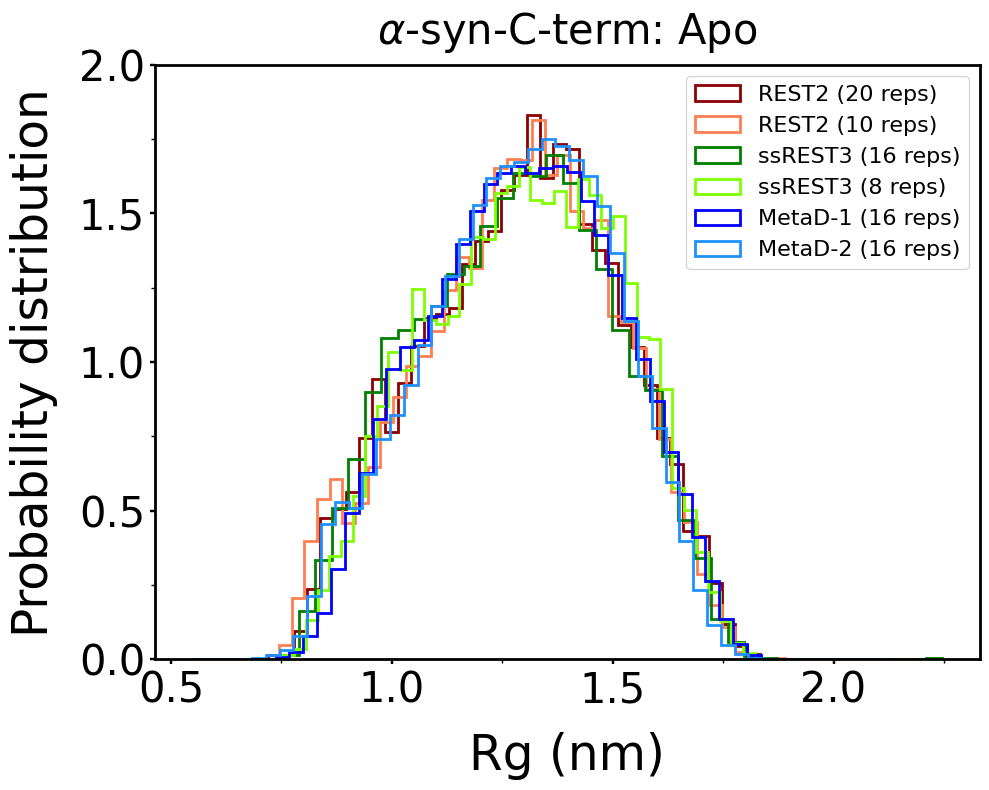

In [ ]:
plt.figure(figsize=(10,8))

i='rep'
l=len(data_dir)+2

for val in range(l):
    if i=='rep': 
        label_=title_[val]  
    else:
        label_="Demux Replica - "+title_[val+1]
    
    if val<=3:
            
        plt.hist(np.array(rg[val][f'{i}:0']),bins=40,density=True,histtype='step',color=color_options[val],label=label_,lw=2)

    else :

        if val==4 : c='combined_1'
        elif val==5 : c='combined_2'

        plt.hist(colvar[c].T[1],bins=50,density=True,label=title_[val],
                    color=color_options[val],histtype='step',linewidth=2,weights=weights_norm[c])
        
    
    plt.tick_params(labelsize=30, width=1.75)
plt.rcParams["axes.linewidth"] = 2
#     plt.setp(ax[val].get_xticklabels(), rotation=45)
    #ax[p,q].set_ylim(1,4)
    #ax[p,q].set_xticks(range(0,142,2))
    #ax[p,q].set_yticks(np.arange(1.0,4.0,0.4))
    
plt.title(r'$\alpha$-syn-C-term: Apo', size=30, pad=15)
plt.yticks(np.arange(0,2.5,0.5), np.arange(0,2.5,0.5))
# plt.xticks(np.arange(0.5,3,0.5), np.arange(0.5,3,0.5))

# Add minor ticks only on x-axis
plt.gca().xaxis.set_minor_locator(plt.MultipleLocator(0.5/2))
plt.tick_params(axis='x', which='minor', length=3, width=1, color='k', direction='out')

# Add minor ticks only on y-axis
plt.gca().yaxis.set_minor_locator(plt.MultipleLocator(0.5/2))
plt.tick_params(axis='y', which='minor', length=3, width=1, color='k', direction='out')

plt.legend(loc='best', fontsize=16) # bbox_to_anchor=(1, 0.5)
plt.ylabel("Probability distribution", size=35, labelpad=15)
plt.xlabel('Rg (nm)', size=35, labelpad=15)
# plt.grid(alpha=0.3)       
plt.tight_layout()
# plt.savefig(f"{out_dir}/rg_hist.png", dpi=1200, bbox_inches='tight')
# plt.clf()


## Protein+Fasudil

In [ ]:
data_dir=np.array([ f'{w_dir}/REST2/data_fas_20/',
f'{w_dir}/REST2/data_fas_10/',
f'{w_dir}/ssREST3/data_fas_16/',
f'{w_dir}/ssREST3/data_fas_8/',
f'{meta_dir}/fas_1/data/out_0/',
f'{meta_dir}/fas_2/data/out_0/',])

In [ ]:
print('Meta-Dynamics Weights')
weights_norm={}
colvar={}

file_1=f'{meta_dir}/fas_1/colvar/colvar_0.dat'
file_2=f'{meta_dir}/fas_2/colvar/colvar_0.dat'

num_cvs_1, weights_1, weights_norm['combined_1'] = norm_weights(file_1)
num_cvs_2, weights_2, weights_norm['combined_2'] = norm_weights(file_2)

print("No of CV's :", (num_cvs_1-1,num_cvs_2-1))
print(f"Sum of combined xtc : {np.sum(weights_norm['combined_1'])} , {np.sum(weights_norm['combined_2'])}")

colvar['combined_1']=np.loadtxt(file_1,comments=['@','#'])
colvar['combined_2']=np.loadtxt(file_2,comments=['@','#'])

Meta-Dynamics Weights
No of CV's : (12, 12)
Sum of combined xtc : 1.0 , 1.0000000000000004


In [ ]:

rg={}

p=0
for i in data_dir[:-2]:

    rg[p]=json.load(open(i+'rg.json','r'))
    
    p+=1

In [ ]:
mean_list=[]

for val in range(len(data_dir[:-2])):
    
    a=[]
    for i in range(nrep[val]):

        a.append(get_blockerror_pyblock_nanskip(np.array(rg[val][f'rep:{i}'])))

    mean_list.append(np.array(a))

mean_list=np.array(mean_list, dtype=object)


In [ ]:
rg_pb1, rg_pb1_e=get_blockerror_pyblock_nanskip_rw_(colvar['combined_1'].T[1], weights=weights_norm['combined_1'])
rg_pb2, rg_pb2_e=get_blockerror_pyblock_nanskip_rw_(colvar['combined_2'].T[1], weights=weights_norm['combined_2'])


## Ploting REST-2 data Vs temperature

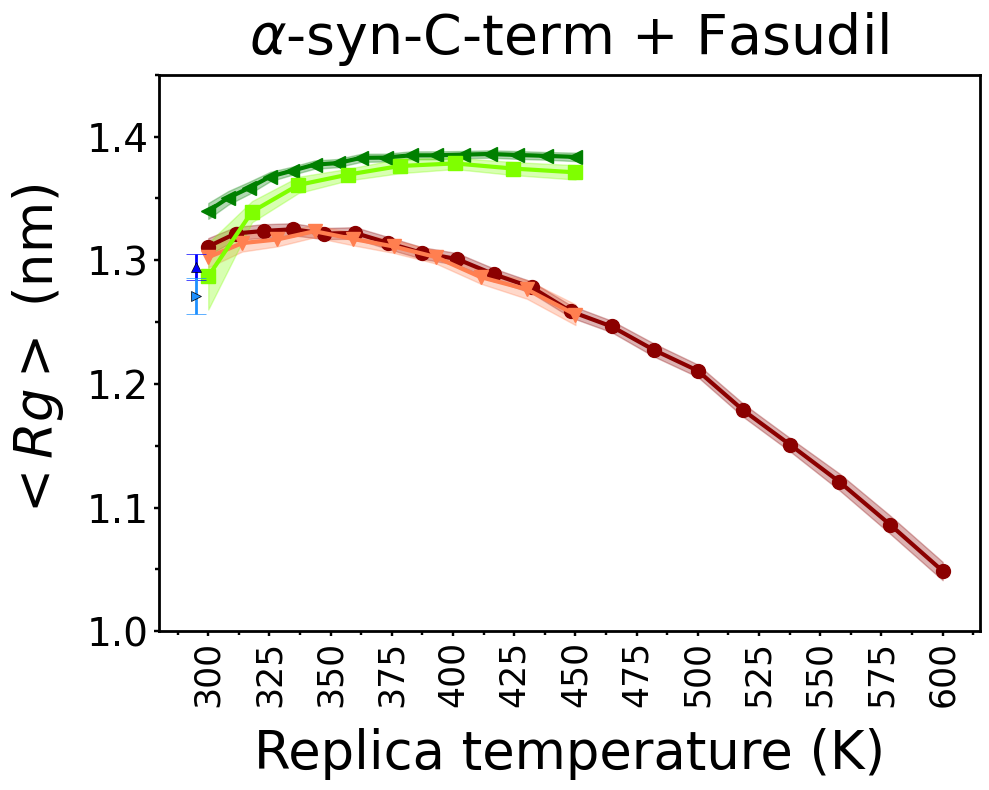

In [ ]:
marker=['o','v','<', 's','^','>']
color=['black', 'red', 'blue', 'green']
plt.figure(figsize=(10,8))

for val in range(len(data_dir[:-2])):
    
    # plt.errorbar(temperature[val], mean_list[val].T[0], yerr=mean_list[val].T[1],fmt=marker[val], color=color_options[val], label=title_[val], elinewidth=2, capsize=7, mec='black', mew=0.5, ms=6.8)
    plt.plot(temperature[val], mean_list[val].T[0], color=color_options[val], label=title_[val], linewidth=3, marker=marker[val], markersize=10)
    plt.fill_between(temperature[val], mean_list[val].T[0]-mean_list[val].T[1], mean_list[val].T[0]+mean_list[val].T[1], color=color_options[val], alpha=0.3)

plt.errorbar(temperature[0][0]-5, rg_pb1, yerr=rg_pb1_e,fmt=marker[4], color=color_options[4], label=title_[4], elinewidth=2, capsize=7, mec='black', mew=0.5, ms=6.8)
plt.errorbar(temperature[0][0]-5, rg_pb2, yerr=rg_pb2_e,fmt=marker[5], color=color_options[5], label=title_[5], elinewidth=2, capsize=7, mec='black', mew=0.5, ms=6.8)

plt.tick_params(labelsize=28, width=1.75)
plt.rcParams["axes.linewidth"] = 2

# plt.setp(ax.spines.values(), lw=5, alpha=0.2)
#plt.set_ylim(0.6,2.0)
# plt.xticks(range(0,22,2))
plt.xticks(range(300,625,25),size=25, rotation=90)
plt.yticks(np.arange(1.0,1.45,0.1))
plt.ylim(1.0,1.45)

plt.title(r'$\alpha$-syn-C-term + Fasudil', size=40, pad=15)

plt.ylabel(r"$< Rg >$ (nm)", fontsize=38, labelpad=15)
# plt.xlabel('Number of replicas', size=30, labelpad=15)
plt.xlabel('Replica temperature (K)', fontsize=38, labelpad=15)

# Add minor ticks only on x-axis
plt.gca().xaxis.set_minor_locator(plt.MultipleLocator(25/2))
plt.tick_params(axis='x', which='minor', length=3, width=1.75, color='k', direction='out')

# Add minor ticks only on y-axis
plt.gca().yaxis.set_minor_locator(plt.MultipleLocator(0.1/2))
plt.tick_params(axis='y', which='minor', length=3, width=1.75, color='k', direction='out')

# plt.legend(fontsize=18, loc='best') 

plt.tight_layout()

plt.savefig(f'{out_dir}/r2_rg_vs_temp_fas.png', dpi=1200, bbox_inches='tight')


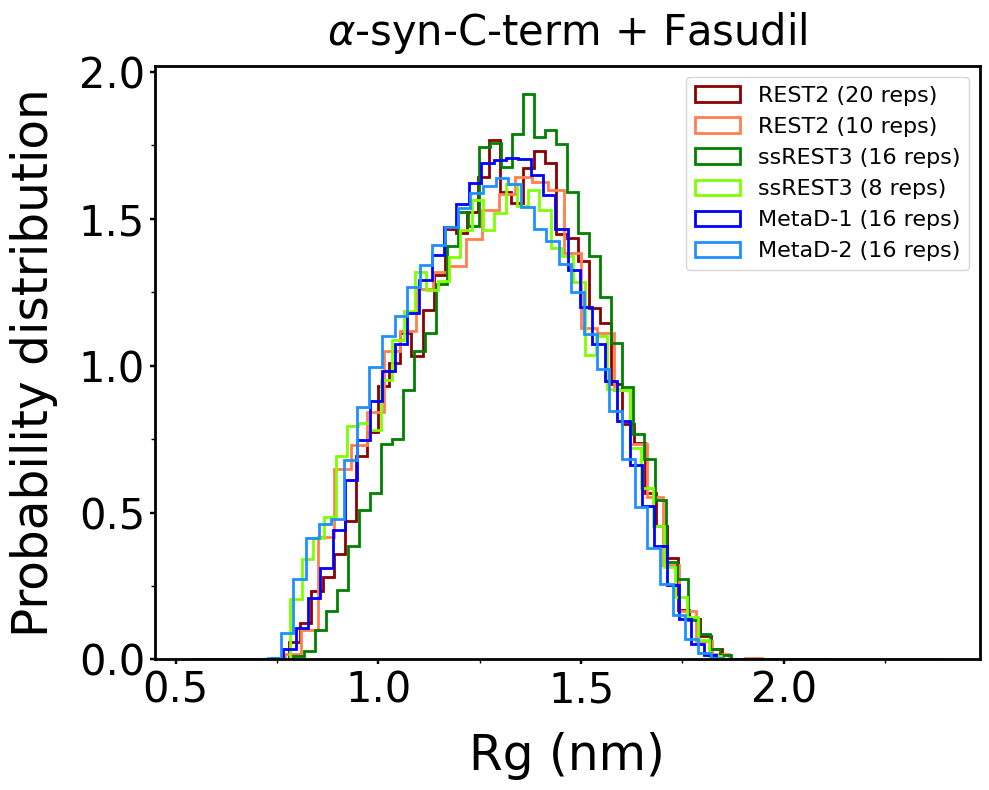

In [ ]:
plt.figure(figsize=(10,8))

i='rep'
l=len(data_dir)

for val in range(l):
    if i=='rep': 
        label_=title_[val]  
    else:
        label_="Demux Replica - "+title_[val+1]
    
    if val<=3:
            
        plt.hist(np.array(rg[val][f'{i}:0']),bins=40,density=True,histtype='step',color=color_options[val],label=label_,lw=2)

    else :

        if val==4 : c='combined_1'
        elif val==5 : c='combined_2'

        plt.hist(colvar[c].T[1],bins=50,density=True,label=title_[val],
                    color=color_options[val],histtype='step',linewidth=2,weights=weights_norm[c])
        
    
    plt.tick_params(labelsize=30, width=1.75)
plt.rcParams["axes.linewidth"] = 1.75
#     plt.setp(ax[val].get_xticklabels(), rotation=45)
    #ax[p,q].set_ylim(1,4)
    #ax[p,q].set_xticks(range(0,142,2))
    #ax[p,q].set_yticks(np.arange(1.0,4.0,0.4))
    
plt.title(r'$\alpha$-syn-C-term + Fasudil', size=30, pad=15)
plt.yticks(np.arange(0,2.5,0.5), np.arange(0,2.5,0.5))
# plt.xticks(np.arange(0.5,3,0.5), np.arange(0.5,3,0.5))

# Add minor ticks only on x-axis
plt.gca().xaxis.set_minor_locator(plt.MultipleLocator(0.5/2))
plt.tick_params(axis='x', which='minor', length=3, width=1, color='k', direction='out')

# Add minor ticks only on y-axis
plt.gca().yaxis.set_minor_locator(plt.MultipleLocator(0.5/2))
plt.tick_params(axis='y', which='minor', length=3, width=1, color='k', direction='out')

plt.legend(loc='best', fontsize=16) # bbox_to_anchor=(1, 0.5)
plt.ylabel("Probability distribution", size=35, labelpad=15)
plt.xlabel('Rg (nm)', size=35, labelpad=15)
# plt.grid(alpha=0.3)       
plt.tight_layout()
# plt.savefig(f"{out_dir}/rg_hist.png", dpi=1200, bbox_inches='tight')
# plt.clf()
# plt.savefig(data_dir+'rg_rep_hist_all.png',dpi=210)

## Ligand 47

In [ ]:
data_dir=np.array([ f'{w_dir}/REST2/data_lig47_20/',
f'{w_dir}/REST2/data_lig47_10/',
f'{w_dir}/ssREST3/data_lig47_16/',
f'{w_dir}/ssREST3/data_lig47_8/',
f'{meta_dir}/lig47_1/data/out_0/',
f'{meta_dir}/lig47_2/data/out_0/',])

In [ ]:
print('Meta-Dynamics Weights')
weights_norm={}
colvar={}

file_1=f'{meta_dir}/lig47_1/colvar/colvar_0.dat'
file_2=f'{meta_dir}/lig47_2/colvar/colvar_0.dat'

num_cvs_1, weights_1, weights_norm['combined_1'] = norm_weights(file_1)
num_cvs_2, weights_2, weights_norm['combined_2'] = norm_weights(file_2)

print("No of CV's :", (num_cvs_1-1,num_cvs_2-1))
print(f"Sum of combined xtc : {np.sum(weights_norm['combined_1'])} , {np.sum(weights_norm['combined_2'])}")

colvar['combined_1']=np.loadtxt(file_1,comments=['@','#'])
colvar['combined_2']=np.loadtxt(file_2,comments=['@','#'])

Meta-Dynamics Weights
No of CV's : (12, 12)
Sum of combined xtc : 1.0000000000000007 , 0.9999999999999999


In [ ]:

rg={}

p=0
for i in data_dir[:-2]:

    rg[p]=json.load(open(i+'rg.json','r'))
    
    p+=1

In [ ]:
mean_list=[]

for val in range(len(data_dir[:-2])):
    
    a=[]
    for i in range(nrep[val]):

        a.append(get_blockerror_pyblock_nanskip(np.array(rg[val][f'rep:{i}'])))

    mean_list.append(np.array(a))

mean_list=np.array(mean_list, dtype=object)


In [ ]:
rg_pb1, rg_pb1_e=get_blockerror_pyblock_nanskip_rw_(colvar['combined_1'].T[1], weights=weights_norm['combined_1'])
rg_pb2, rg_pb2_e=get_blockerror_pyblock_nanskip_rw_(colvar['combined_2'].T[1], weights=weights_norm['combined_2'])


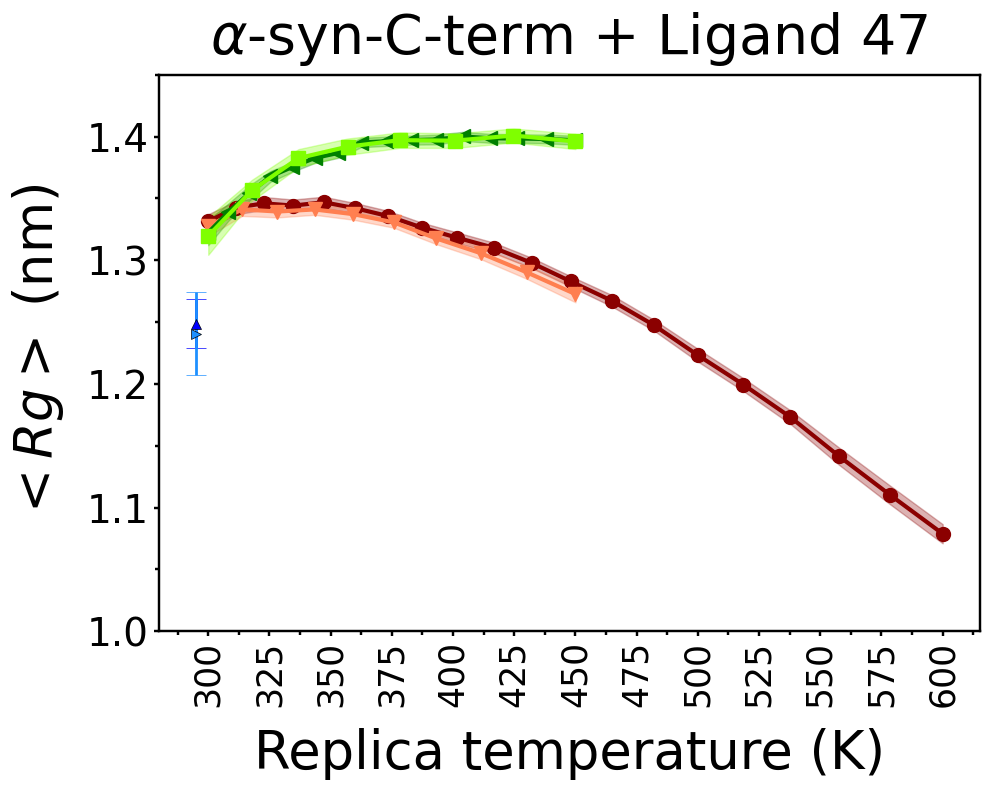

In [ ]:
marker=['o','v','<', 's','^','>']
color=['black', 'red', 'blue', 'green']
plt.figure(figsize=(10,8))

for val in range(len(data_dir[:-2])):
    
    # plt.errorbar(temperature[val], mean_list[val].T[0], yerr=mean_list[val].T[1],fmt=marker[val], color=color_options[val], label=title_[val], elinewidth=2, capsize=7, mec='black', mew=0.5, ms=6.8)
    plt.plot(temperature[val], mean_list[val].T[0], color=color_options[val], label=title_[val], linewidth=3, marker=marker[val], markersize=10)
    plt.fill_between(temperature[val], mean_list[val].T[0]-mean_list[val].T[1], mean_list[val].T[0]+mean_list[val].T[1], color=color_options[val], alpha=0.3)

plt.errorbar(temperature[0][0]-5, rg_pb1, yerr=rg_pb1_e,fmt=marker[4], color=color_options[4], label=title_[4], elinewidth=2, capsize=7, mec='black', mew=0.5, ms=6.8)
plt.errorbar(temperature[0][0]-5, rg_pb2, yerr=rg_pb2_e,fmt=marker[5], color=color_options[5], label=title_[5], elinewidth=2, capsize=7, mec='black', mew=0.5, ms=6.8)

plt.tick_params(labelsize=28, width=1.75)
plt.rcParams["axes.linewidth"] = 2

# plt.setp(ax.spines.values(), lw=5, alpha=0.2)
#plt.set_ylim(0.6,2.0)
# plt.xticks(range(0,22,2))
plt.xticks(range(300,625,25),size=25, rotation=90)
plt.yticks(np.arange(1.0,1.45,0.1))
plt.ylim(1.0,1.45)

plt.title(r'$\alpha$-syn-C-term + Ligand 47', size=40, pad=15)

plt.ylabel(r"$< Rg >$ (nm)", fontsize=38, labelpad=15)
# plt.xlabel('Number of replicas', size=30, labelpad=15)
plt.xlabel('Replica temperature (K)', fontsize=38, labelpad=15)

# Add minor ticks only on x-axis
plt.gca().xaxis.set_minor_locator(plt.MultipleLocator(25/2))
plt.tick_params(axis='x', which='minor', length=3, width=1.75, color='k', direction='out')

# Add minor ticks only on y-axis
plt.gca().yaxis.set_minor_locator(plt.MultipleLocator(0.1/2))
plt.tick_params(axis='y', which='minor', length=3, width=1.75, color='k', direction='out')

# plt.legend(fontsize=18, loc='best') 

plt.tight_layout()

plt.savefig(f'{out_dir}/r2_rg_vs_temp_lig47.png', dpi=1200, bbox_inches='tight')


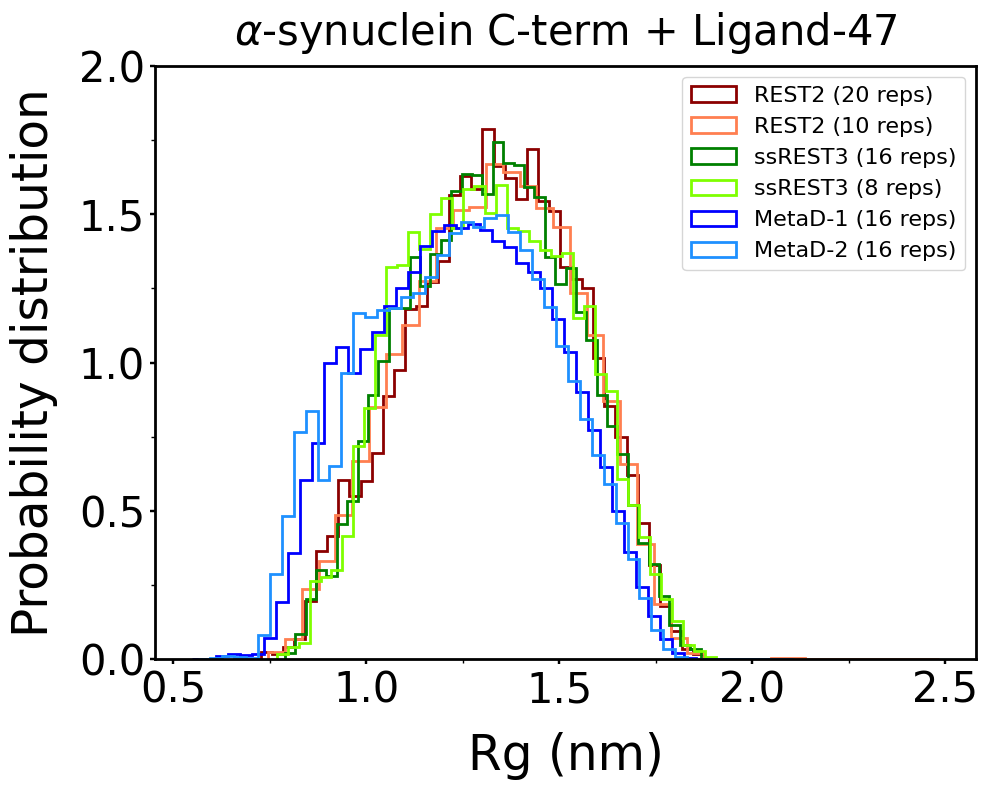

In [ ]:
plt.figure(figsize=(10,8))

i='rep'
l=len(data_dir)

for val in range(l):
    if i=='rep': 
        label_=title_[val]  
    else:
        label_="Demux Replica - "+title_[val+1]
    
    if val<=3:
            
        plt.hist(np.array(rg[val][f'{i}:0']),bins=40,density=True,histtype='step',color=color_options[val],label=label_,lw=2)

    else :

        if val==4 : c='combined_1'
        elif val==5 : c='combined_2'

        plt.hist(colvar[c].T[1],bins=50,density=True,label=title_[val],
                    color=color_options[val],histtype='step',linewidth=2,weights=weights_norm[c])
        
    
    plt.tick_params(labelsize=30, width=1.75)
plt.rcParams["axes.linewidth"] = 1.75
#     plt.setp(ax[val].get_xticklabels(), rotation=45)
    #ax[p,q].set_ylim(1,4)
    #ax[p,q].set_xticks(range(0,142,2))
    #ax[p,q].set_yticks(np.arange(1.0,4.0,0.4))
    
plt.title(r'$\alpha$-synuclein C-term + Ligand-47', size=30, pad=15)
plt.yticks(np.arange(0,2.5,0.5), np.arange(0,2.5,0.5))
# plt.xticks(np.arange(0.5,3,0.5), np.arange(0.5,3,0.5))

# Add minor ticks only on x-axis
plt.gca().xaxis.set_minor_locator(plt.MultipleLocator(0.5/2))
plt.tick_params(axis='x', which='minor', length=3, width=1, color='k', direction='out')

# Add minor ticks only on y-axis
plt.gca().yaxis.set_minor_locator(plt.MultipleLocator(0.5/2))
plt.tick_params(axis='y', which='minor', length=3, width=1, color='k', direction='out')

plt.legend(loc='best', fontsize=16) # bbox_to_anchor=(1, 0.5)
plt.ylabel("Probability distribution", size=35, labelpad=15)
plt.xlabel('Rg (nm)', size=35, labelpad=15)
# plt.grid(alpha=0.3)       
plt.tight_layout()
# plt.savefig(f"{out_dir}/rg_hist.png", dpi=1200, bbox_inches='tight')
# plt.clf()
# plt.savefig(data_dir+'rg_rep_hist_all.png',dpi=210)

## Load data for Protein-Fasudil contacts

In [ ]:
contact={}

p=0
for i in data_dir_f:
    
    if p>=4 : 
        
        contact[p]=json.load(open(i+'avg_ligand_contacts_rw.json','r'))
        
    else :
        
        contact[p]=json.load(open(i+'avg_ligand_contacts.json','r'))
    
    p+=1

## 2D protein:fasudil contact plot

In [ ]:
fig, axes = plt.subplots(1,1,figsize=(10,8), dpi=1200)
marker=['o','v','<','^','>']
yl=r'Probability Distribution'
# colors=['navy', 'royalblue',
#         'darkgreen', 'lime',
#         'darkred', 'hotpink']
# colors=['red', 'green', 'blue', 'darkorange', 'purple', 'saddlebrown']
colors=['darkred', 'coral', 'green', 'lightgreen', 'blue', 'dodgerblue']


for i in range(len(data_dir_f)):
      
    if i<4 :
        
        axes.plot(np.array(contact[i]['rep:0']).T[0],np.array(contact[i]['rep:0']).T[1], color=colors[i], lw=2, ms=7,label=title_[i])
        axes.fill_between(np.array(contact[i]['rep:0']).T[0], np.array(contact[i]['rep:0']).T[1]-np.array(contact[i]['rep:0']).T[2],
                     np.array(contact[i]['rep:0']).T[1]+np.array(contact[i]['rep:0']).T[2], color=colors[i], alpha=0.3)
    else :
        
        axes.plot(np.array(contact[i]['0']).T[0],np.array(contact[i]['0']).T[1], color=colors[i], lw=2, ms=7,label=title_[i])
        axes.fill_between(np.array(contact[i]['0']).T[0], np.array(contact[i]['0']).T[1]-np.array(contact[i]['0']).T[2],
                     np.array(contact[i]['0']).T[1]+np.array(contact[i]['0']).T[2], color=colors[i], alpha=0.3)
    
    axes.tick_params(labelsize=25, width=1.75)
    plt.rcParams["axes.linewidth"] = 1.75
    # axes.grid(alpha=0.4)
    plt.setp(axes.get_xticklabels(), rotation=90)
    axes.set_ylim(0,0.3)
    axes.set_xlim(120,141)
    # ax[val].set_xticks(range(121,141,2), b[::2])
    axes.set_xticks(range(121,141,2), range(121,141,2),rotation=90)
    axes.set_yticks(np.arange(0, 0.4, 0.1))
    # axes.legend( fontsize=18, ncol=3) 
    axes.set_ylabel(yl, size=28, labelpad=15)
    axes.set_xlabel('Protein Residues', size=30, labelpad=15)

    axes.set_title(r'$\alpha$-syn-C-term + Fasudil', size=30, pad=15)

    plt.gca().xaxis.set_minor_locator(plt.MultipleLocator(1))
    axes.tick_params(axis='x', which='minor', length=3, width=1, color='k', direction='out')
    # axes.set_title("Ligand contact probability", size=25)

    plt.gca().yaxis.set_minor_locator(plt.MultipleLocator(0.1/2))
    axes.tick_params(axis='y', which='minor', length=3, width=1, color='k', direction='out')

    ax2 = axes.twiny()

    # Set custom labels for the top x-axis
    # top_labels = ticks_pname[::2]
    # top_tick_positions = range(0, 20, 2)

    # Use invisible spines and set labels for the top x-axis
    ax2.spines['top'].set_position(('outward', 0))
    ax2.spines['top'].set_visible(True)
    ax2.spines['bottom'].set_position(('outward', 0))
    ax2.spines['bottom'].set_visible(False)
    ax2.set_xlim(120,141)
    ax2.set_xticks(range(121,141), ticks_pname[::])
    axes.tick_params(width=1.75)
    # ax2.set_xticklabels(top_labels)
    ax2.tick_params(axis='x', labelsize=20)
    plt.gca().xaxis.set_minor_locator(plt.MultipleLocator(1))
    ax2.tick_params(axis='x', which='minor', length=3, width=1, color='k', direction='out')
 

    
#     text_=r'$K_{D}$'+' : '+str(round(np.array(bf_kd['rep'])[2][val],2))+r'$\pm$'+str(round(np.array(bf_kd['rep'])[3][val],2))
#     ax[p,q].text(120.3, 0.63, text_, fontsize = 28)
    
plt.tight_layout()
plt.savefig(f"{out_dir}/ligand_contact_probability_fas.png", dpi=1200, bbox_inches='tight')

# plt.clf()

## Load data for Protein-Ligand 47 contacts

In [ ]:
contact={}

p=0
for i in data_dir_l:
    
    if p>=4 : 
        
        contact[p]=json.load(open(i+'avg_ligand_contacts_rw.json','r'))
        
    else :
        
        contact[p]=json.load(open(i+'avg_ligand_contacts.json','r'))
    
    p+=1

In [ ]:
fig, axes = plt.subplots(1,1,figsize=(10,8), dpi=1200)
marker=['o','v','<','^','>']
yl=r'Probability Distribution'
# colors=['red', 'green', 'blue', 'darkorange', 'purple', 'saddlebrown']
colors=['darkred', 'coral', 'green', 'lightgreen', 'blue', 'dodgerblue']

for i in range(len(data_dir_l)):
      
    if i<4 :
        
        axes.plot(np.array(contact[i]['rep:0']).T[0],np.array(contact[i]['rep:0']).T[1], color=colors[i], lw=2, ms=7,label=title_[i])
        axes.fill_between(np.array(contact[i]['rep:0']).T[0], np.array(contact[i]['rep:0']).T[1]-np.array(contact[i]['rep:0']).T[2],
                     np.array(contact[i]['rep:0']).T[1]+np.array(contact[i]['rep:0']).T[2], color=colors[i], alpha=0.3)
    else :
        
        axes.plot(np.array(contact[i]['0']).T[0],np.array(contact[i]['0']).T[1], color=colors[i], lw=2, ms=7,label=title_[i])
        axes.fill_between(np.array(contact[i]['0']).T[0], np.array(contact[i]['0']).T[1]-np.array(contact[i]['0']).T[2],
                     np.array(contact[i]['0']).T[1]+np.array(contact[i]['0']).T[2], color=colors[i], alpha=0.3)

    axes.tick_params(labelsize=25, width=1.75)
    plt.rcParams["axes.linewidth"] = 1.75
    # axes.grid(alpha=0.4)
    plt.setp(axes.get_xticklabels(), rotation=90)
    axes.set_ylim(0,0.3)
    axes.set_xlim(120,141)
    # ax[val].set_xticks(range(121,141,2), b[::2])
    axes.set_xticks(range(121,141,2), range(121,141,2),rotation=90)
    axes.set_yticks(np.arange(0, 0.4, 0.1))
    # axes.legend( fontsize=18, ncol=3) 
    axes.set_ylabel(yl, size=28, labelpad=15)
    axes.set_xlabel('Protein Residues', size=30, labelpad=15)

    axes.set_title(r'$\alpha$-syn-C-term + Ligand-47', size=30, pad=15)

    plt.gca().xaxis.set_minor_locator(plt.MultipleLocator(1))
    axes.tick_params(axis='x', which='minor', length=3, width=1, color='k', direction='out')
    # axes.set_title("Ligand contact probability", size=25)

    plt.gca().yaxis.set_minor_locator(plt.MultipleLocator(0.1/2))
    axes.tick_params(axis='y', which='minor', length=3, width=1, color='k', direction='out')

    ax2 = axes.twiny()

    # Set custom labels for the top x-axis
    # top_labels = ticks_pname[::2]
    # top_tick_positions = range(0, 20, 2)

    # Use invisible spines and set labels for the top x-axis
    ax2.spines['top'].set_position(('outward', 0))
    ax2.spines['top'].set_visible(True)
    ax2.spines['bottom'].set_position(('outward', 0))
    ax2.spines['bottom'].set_visible(False)
    ax2.set_xlim(120,141)
    ax2.set_xticks(range(121,141), ticks_pname[::])
    axes.tick_params(width=1.75)
    # ax2.set_xticklabels(top_labels)
    ax2.tick_params(axis='x', labelsize=20)
    plt.gca().xaxis.set_minor_locator(plt.MultipleLocator(1))
    ax2.tick_params(axis='x', which='minor', length=3, width=1, color='k', direction='out')
 

    
#     text_=r'$K_{D}$'+' : '+str(round(np.array(bf_kd['rep'])[2][val],2))+r'$\pm$'+str(round(np.array(bf_kd['rep'])[3][val],2))
#     ax[p,q].text(120.3, 0.63, text_, fontsize = 28)
    
plt.tight_layout()
plt.savefig(f"{out_dir}/ligand_contact_probability_lig47.png", dpi=1200, bbox_inches='tight')

# plt.clf()

In [ ]:
data_dir_a

array(['/data/jk_ssREST3_repo_data/data//REST2/data_apo_20/',
       '/data/jk_ssREST3_repo_data/data//REST2/data_apo_10/',
       '/data/jk_ssREST3_repo_data/data//ssREST3/data_apo_16/',
       '/data/jk_ssREST3_repo_data/data//ssREST3/data_apo_8/',
       '/data/jk_ssREST3_repo_data/data//PBMetaD//apo_1/',
       '/data/jk_ssREST3_repo_data/data//PBMetaD//apo_2/'], dtype='<U53')

## Load data for 3D contact map for protien residue:residue contacts 

In [ ]:
contact_map_p={}


p=0
for i in data_dir_a:
    
    if p>=4 : 
        
        contact_map_p[p]=json.load(open(i+'p_contact_map_re.json','r'))
        
    else :
        
        contact_map_p[p]=json.load(open(i+'p_contact_map.json','r'))
    
    p+=1


Text(0.5, 1, '$\\alpha$-syn-C-term : Apo')

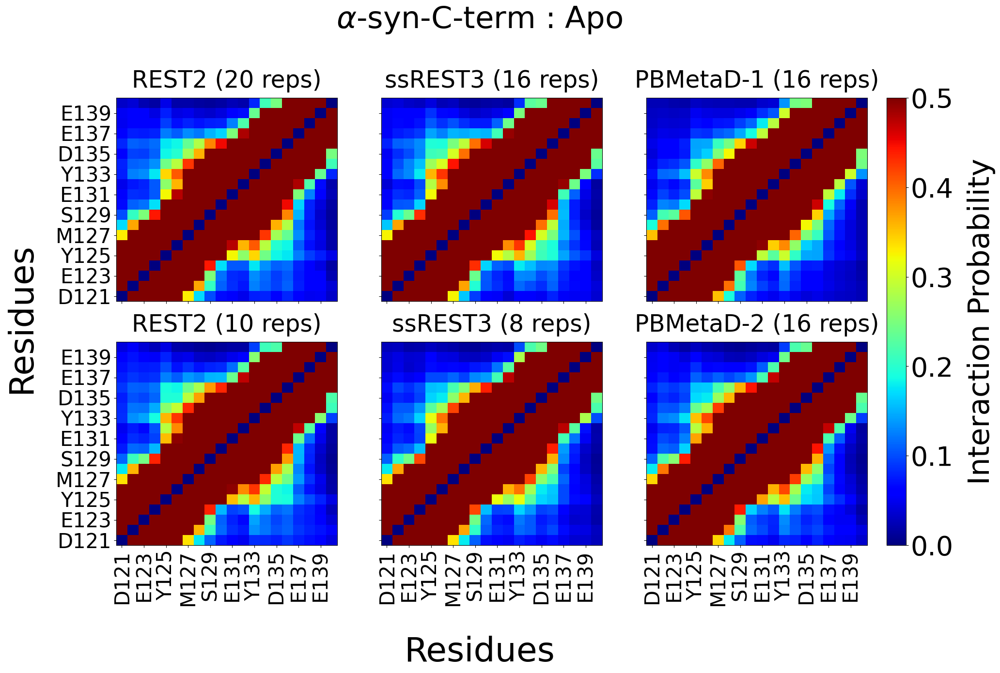

In [ ]:
fig, axes = plt.subplots(2,3, figsize=(20,12), sharex=True, sharey=True)

ax = axes.flatten()

# cax= fig.add_axes([0.93, 0.2, 0.02, 0.6])
# cax = fig.add_axes([axes[2,1].get_position().x1+0.02,axes[2,1].get_position().y0,0.02,axes[0,0].get_position().y1-axes[2,1].get_position().y0])        
# cax = fig.add_axes([axes[2,1].get_position().width-0.24,axes[2,1].get_position().y0-0.09,axes[0,0].get_position().y1-axes[2,1].get_position().y0,0.01])        
cax = fig.add_axes([axes[1,2].get_position().x1+0.02,axes[1,2].get_position().y0,0.02,axes[0,0].get_position().y1-axes[1,2].get_position().y0])        

ax_list={0:0,1:3,2:1,3:4,4:2,5:5} # data_ndx:axes_ndx      

images=[]
for i in range(len(data_dir_a)):
    # ax.set_axis_off()

    if i>=4:
        contact_map = np.array(contact_map_p[i]['re'])
    else:
        contact_map = np.array(contact_map_p[i][f'rep:0'])

    
    # p,q = np.unravel_index(i,(3,2))

    im = ax[ax_list[i]].imshow(contact_map, vmin=0, vmax=0.5,cmap='jet', aspect='auto')
    ax[ax_list[i]].invert_yaxis()
    ax[ax_list[i]].set_xticks(range(0, 20,2), ticks_pnum[::2], rotation=90, size=30)
    ax[ax_list[i]].set_yticks(range(0, 20,2), ticks_pnum[::2], rotation=0, size=30)
    ax[ax_list[i]].grid(False)
    ax[ax_list[i]].set_title(title_[i],size=35, pad=15)

    # if not q : ax[ax_list[i]].set_ylabel("Residues", size=45, labelpad=15)
    # if p == 2-1 : ax[ax_list[i]].set_xlabel('Residues', size=45, labelpad=15)
    images.append(im)

for ax in axes.flat :

    if not bool(ax.has_data()):

        fig.delaxes(ax)

# cbar = fig.colorbar(images[-1],cax=cax, orientation="horizontal")
cbar = fig.colorbar(images[-1],cax=cax)

cbar.set_label("Interaction Probability", size=44, labelpad=20)
cbar.ax.tick_params(labelsize=40)
# cbar.set_ticks([])
# cbar.set_ticklabels([])

fig.text(0.5, -0.09, "Residues", ha="center", fontsize=50)
fig.text(0.01, 0.5, "Residues", va="center", rotation="vertical", fontsize=50)

# plt.suptitle("Protein:protien contact matix",size=50 )
fig.text(0.5, 1, r'$\alpha$-syn-C-term : Apo', ha="center", fontsize=45)

# plt.grid(alpha=0.1)
# plt.tight_layout()
# plt.savefig(f"{out_dir}/p_cm_apo.png", dpi=1200, bbox_inches='tight')
# plt.savefig(f"{out_dir}/p_cm.pdf", dpi=1200, bbox_inches='tight')
# plt.savefig(f"{out_dir}/p_cm.eps", dpi=1200, bbox_inches='tight')

# plt.show()
# plt.clf()


In [ ]:
data_dir_f

array(['/data/jk_ssREST3_repo_data/data//REST2/data_fas_20/',
       '/data/jk_ssREST3_repo_data/data//REST2/data_fas_10/',
       '/data/jk_ssREST3_repo_data/data//ssREST3/data_fas_16/',
       '/data/jk_ssREST3_repo_data/data//ssREST3/data_fas_8/',
       '/data/jk_ssREST3_repo_data/data//PBMetaD//fas_1/data/out_0/',
       '/data/jk_ssREST3_repo_data/data//PBMetaD//fas_2/data/out_0/'],
      dtype='<U59')

## Protein:Ligand dual contact map for Fasudil

In [ ]:
contact_map_l={}

p=0
for i in data_dir_f:
    

    if p>=4 : 
        
        contact_map_l[p]=json.load(open(i+'l_contact_map_re.json','r'))
        
    else :
        
        contact_map_l[p]=json.load(open(i+'l_contact_map.json','r'))
    
    p+=1

Text(0.5, 1, '$\\alpha$-syn-C-term + Fasudil')

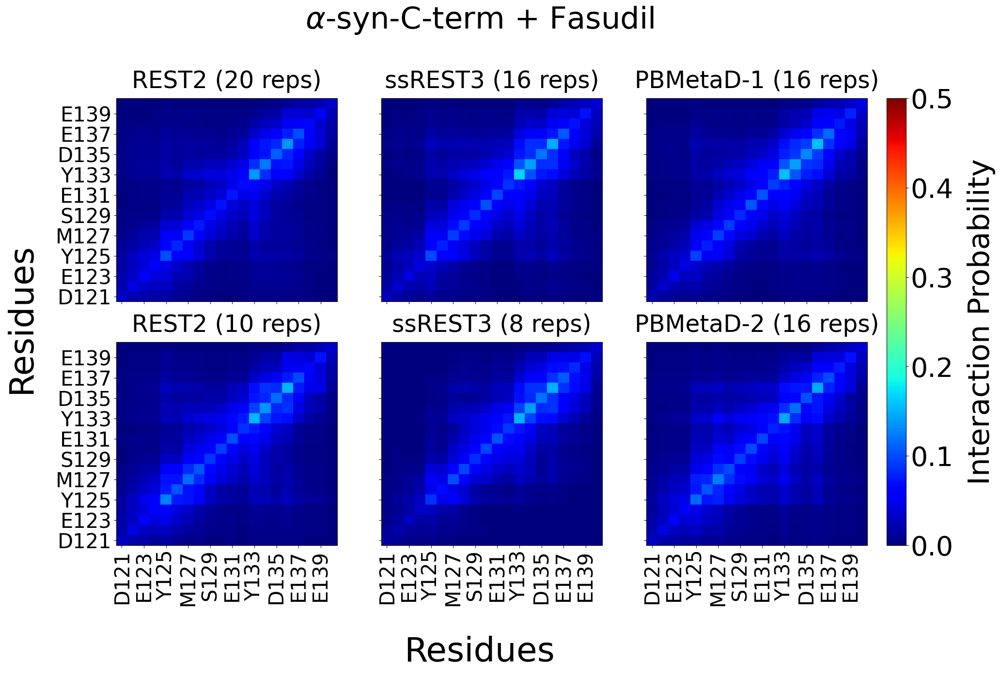

In [ ]:
from mpl_toolkits.axes_grid1 import AxesGrid

fig, axes = plt.subplots(2,3, figsize=(20,12), sharex=True, sharey=True)

ax = axes.flatten()

# cax= fig.add_axes([0.93, 0.2, 0.02, 0.6])
# cax = fig.add_axes([axes[2,1].get_position().x1+0.02,axes[2,1].get_position().y0,0.02,axes[0,0].get_position().y1-axes[2,1].get_position().y0])        
# cax = fig.add_axes([axes[2,1].get_position().width-0.24,axes[2,1].get_position().y0-0.09,axes[0,0].get_position().y1-axes[2,1].get_position().y0,0.01])        
cax = fig.add_axes([axes[1,2].get_position().x1+0.02,axes[1,2].get_position().y0,0.02,axes[0,0].get_position().y1-axes[1,2].get_position().y0])        

ax_list={0:0,1:3,2:1,3:4,4:2,5:5} # data_ndx:axes_ndx

images=[]
for i in range(len(data_dir_l)):
    # ax.set_axis_off()

    if i>=4:
        contact_map = np.array(contact_map_l[i]['0'])
    else:
        contact_map = np.array(contact_map_l[i][f'rep:0'])

    
    # p,q = np.unravel_index(i,(3,2))

    im = ax[ax_list[i]].imshow(contact_map, vmin=0, vmax=0.5,cmap='jet', aspect='auto')
    ax[ax_list[i]].invert_yaxis()
    ax[ax_list[i]].set_xticks(range(0, 20,2), ticks_pnum[::2], rotation=90, size=30)
    ax[ax_list[i]].set_yticks(range(0, 20,2), ticks_pnum[::2], rotation=0, size=30)
    ax[ax_list[i]].grid(False)
    ax[ax_list[i]].set_title(title_[i],size=35, pad=15)

    # if not q : ax[ax_list[i]].set_ylabel("Residues", size=45, labelpad=15)
    # if p == 2-1 : ax[ax_list[i]].set_xlabel('Residues', size=45, labelpad=15)
    images.append(im)

for ax in axes.flat :

    if not bool(ax.has_data()):

        fig.delaxes(ax)

# cbar = fig.colorbar(images[-1],cax=cax, orientation="horizontal")
cbar = fig.colorbar(images[-1],cax=cax)

cbar.set_label("Interaction Probability", size=44, labelpad=20)
cbar.ax.tick_params(labelsize=40)
# cbar.set_ticks([])
# cbar.set_ticklabels([])

fig.text(0.5, -0.09, "Residues", ha="center", fontsize=50)
fig.text(0.01, 0.5, "Residues", va="center", rotation="vertical", fontsize=50)

# plt.suptitle("Protein:protien contact matix",size=50 )
fig.text(0.5, 1, r'$\alpha$-syn-C-term + Fasudil', ha="center", fontsize=45)

# plt.tight_layout()
# plt.savefig(f"{out_dir}/l_cm_fas.png", dpi=1200, bbox_inches='tight')
# plt.savefig(f"{out_dir}/p_cm.pdf", dpi=1200, bbox_inches='tight')
# plt.savefig(f"{out_dir}/l_cm_fas.eps", dpi=1200, bbox_inches='tight')

# plt.show()
# plt.clf()


## Protein contact map : Fasudil

In [ ]:
contact_map_p={}

p=0
for i in data_dir_f:
    

    if p>=4 : 
        
        contact_map_p[p]=json.load(open(i+'p_contact_map_re.json','r'))
        
    else :
        
        contact_map_p[p]=json.load(open(i+'p_contact_map.json','r'))
    
    p+=1

Text(0.5, 1, '$\\alpha$-syn-C-term : Fasudil')

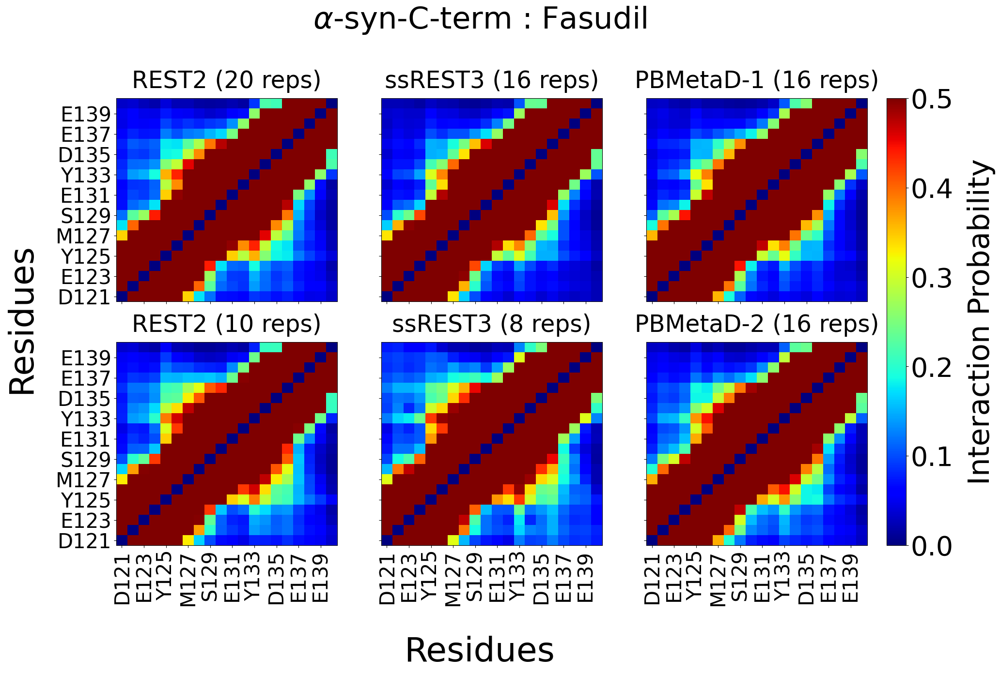

In [ ]:
fig, axes = plt.subplots(2,3, figsize=(20,12), sharex=True, sharey=True)

ax = axes.flatten()

# cax= fig.add_axes([0.93, 0.2, 0.02, 0.6])
# cax = fig.add_axes([axes[2,1].get_position().x1+0.02,axes[2,1].get_position().y0,0.02,axes[0,0].get_position().y1-axes[2,1].get_position().y0])        
# cax = fig.add_axes([axes[2,1].get_position().width-0.24,axes[2,1].get_position().y0-0.09,axes[0,0].get_position().y1-axes[2,1].get_position().y0,0.01])        
cax = fig.add_axes([axes[1,2].get_position().x1+0.02,axes[1,2].get_position().y0,0.02,axes[0,0].get_position().y1-axes[1,2].get_position().y0])        

ax_list={0:0,1:3,2:1,3:4,4:2,5:5} # data_ndx:axes_ndx 

images=[]
for i in range(len(data_dir_f)):
    # ax.set_axis_off()

    if i>=4:
        contact_map = np.array(contact_map_p[i]['0'])
    else:
        contact_map = np.array(contact_map_p[i][f'rep:0'])

    
    # p,q = np.unravel_index(i,(3,2))

    im = ax[ax_list[i]].imshow(contact_map, vmin=0, vmax=0.5,cmap='jet', aspect='auto')
    ax[ax_list[i]].invert_yaxis()
    ax[ax_list[i]].set_xticks(range(0, 20,2), ticks_pnum[::2], rotation=90, size=30)
    ax[ax_list[i]].set_yticks(range(0, 20,2), ticks_pnum[::2], rotation=0, size=30)
    ax[ax_list[i]].grid(False)
    ax[ax_list[i]].set_title(title_[i],size=35, pad=15)

    # if not q : ax[ax_list[i]].set_ylabel("Residues", size=45, labelpad=15)
    # if p == 2-1 : ax[ax_list[i]].set_xlabel('Residues', size=45, labelpad=15)
    images.append(im)

for ax in axes.flat :

    if not bool(ax.has_data()):

        fig.delaxes(ax)

# cbar = fig.colorbar(images[-1],cax=cax, orientation="horizontal")
cbar = fig.colorbar(images[-1],cax=cax)

cbar.set_label("Interaction Probability", size=44, labelpad=20)
cbar.ax.tick_params(labelsize=40)
# cbar.set_ticks([])
# cbar.set_ticklabels([])

fig.text(0.5, -0.09, "Residues", ha="center", fontsize=50)
fig.text(0.01, 0.5, "Residues", va="center", rotation="vertical", fontsize=50)

fig.text(0.5, 1, r'$\alpha$-syn-C-term : Fasudil', ha="center", fontsize=45)

# plt.tight_layout()
# plt.savefig(f"{out_dir}/p_cm_fas.png", dpi=1200, bbox_inches='tight')
# plt.savefig(f"{out_dir}/p_cm.pdf", dpi=1200, bbox_inches='tight')
# plt.savefig(f"{out_dir}/p_cm.eps", dpi=1200, bbox_inches='tight')

# plt.show()
# plt.clf()


## Protein:Ligand dual contact map for Ligand 47

In [ ]:
contact_map_l={}

p=0
for i in data_dir_l:
    
    if p<4:
        contact_map_l[p]=json.load(open(i+'l_contact_map.json','r'))
    else:
        contact_map_l[p]=json.load(open(i+'l_contact_map_re.json','r'))
    p+=1

Text(0.5, 1, '$\\alpha$-syn-C-term + Ligand-47')

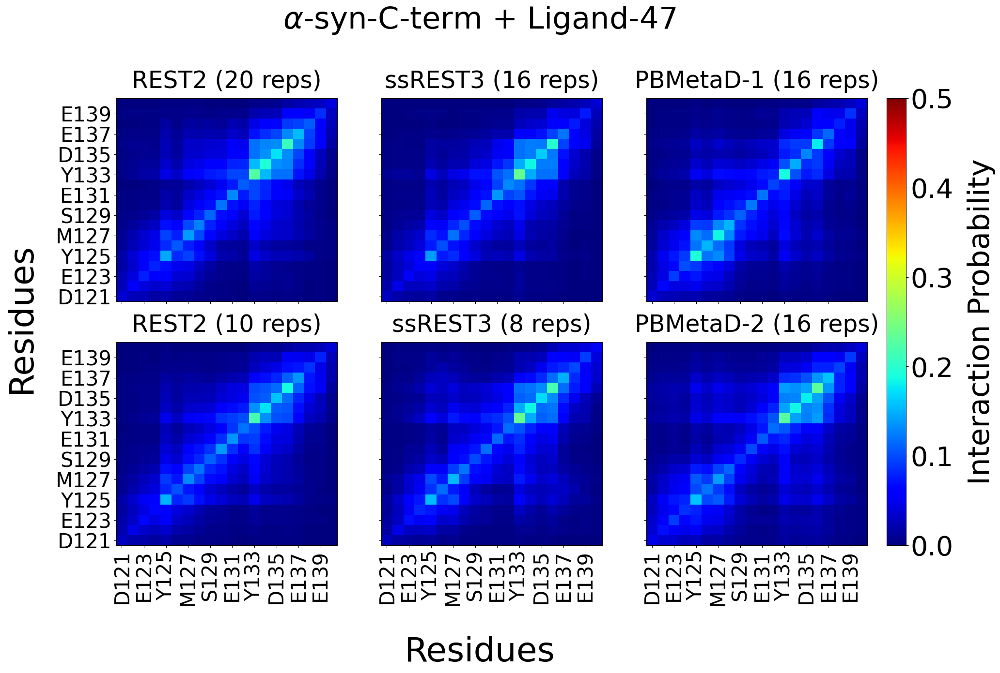

In [ ]:
from mpl_toolkits.axes_grid1 import AxesGrid

fig, axes = plt.subplots(2,3, figsize=(20,12), sharex=True, sharey=True)

ax = axes.flatten()

# cax= fig.add_axes([0.93, 0.2, 0.02, 0.6])
# cax = fig.add_axes([axes[2,1].get_position().x1+0.02,axes[2,1].get_position().y0,0.02,axes[0,0].get_position().y1-axes[2,1].get_position().y0])        
# cax = fig.add_axes([axes[2,1].get_position().width-0.24,axes[2,1].get_position().y0-0.09,axes[0,0].get_position().y1-axes[2,1].get_position().y0,0.01])        
cax = fig.add_axes([axes[1,2].get_position().x1+0.02,axes[1,2].get_position().y0,0.02,axes[0,0].get_position().y1-axes[1,2].get_position().y0])        

ax_list={0:0,1:3,2:1,3:4,4:2,5:5} # data_ndx:axes_ndx

images=[]
for i in range(len(data_dir_l)):
    # ax.set_axis_off()

    if i>=4:
        contact_map = np.array(contact_map_l[i]['0'])
    else:
        contact_map = np.array(contact_map_l[i][f'rep:0'])

    
    # p,q = np.unravel_index(i,(3,2))

    im = ax[ax_list[i]].imshow(contact_map, vmin=0, vmax=0.5,cmap='jet', aspect='auto')
    ax[ax_list[i]].invert_yaxis()
    ax[ax_list[i]].set_xticks(range(0, 20,2), ticks_pnum[::2], rotation=90, size=30)
    ax[ax_list[i]].set_yticks(range(0, 20,2), ticks_pnum[::2], rotation=0, size=30)
    ax[ax_list[i]].grid(False)
    ax[ax_list[i]].set_title(title_[i],size=35, pad=15)

    # if not q : ax[ax_list[i]].set_ylabel("Residues", size=45, labelpad=15)
    # if p == 2-1 : ax[ax_list[i]].set_xlabel('Residues', size=45, labelpad=15)
    images.append(im)

for ax in axes.flat :

    if not bool(ax.has_data()):

        fig.delaxes(ax)

# cbar = fig.colorbar(images[-1],cax=cax, orientation="horizontal")
cbar = fig.colorbar(images[-1],cax=cax)

cbar.set_label("Interaction Probability", size=44, labelpad=20)
cbar.ax.tick_params(labelsize=40)
# cbar.set_ticks([])
# cbar.set_ticklabels([])

fig.text(0.5, -0.09, "Residues", ha="center", fontsize=50)
fig.text(0.01, 0.5, "Residues", va="center", rotation="vertical", fontsize=50)

# plt.suptitle("Protein:protien contact matix",size=50 )
fig.text(0.5, 1, r'$\alpha$-syn-C-term + Ligand-47', ha="center", fontsize=45)

# plt.grid(alpha=0.1)
# plt.tight_layout()
# plt.savefig(f"{out_dir}/l_cm_lig47.png", dpi=1200, bbox_inches='tight')
# plt.savefig(f"{out_dir}/l_cm_lig47.pdf", dpi=1200, bbox_inches='tight')
# plt.savefig(f"{out_dir}/p_cm.eps", dpi=1200, bbox_inches='tight')

# plt.show()
# plt.clf()


## Protein contact map for Ligand 47

In [ ]:
contact_map_p={}

p=0
for i in data_dir_l:
    
    if p<4:
        contact_map_p[p]=json.load(open(i+'p_contact_map.json','r'))
    else:
        contact_map_p[p]=json.load(open(i+'p_contact_map_re.json','r'))
    p+=1

Text(0.5, 1, '$\\alpha$-syn-C-term : Ligand-47')

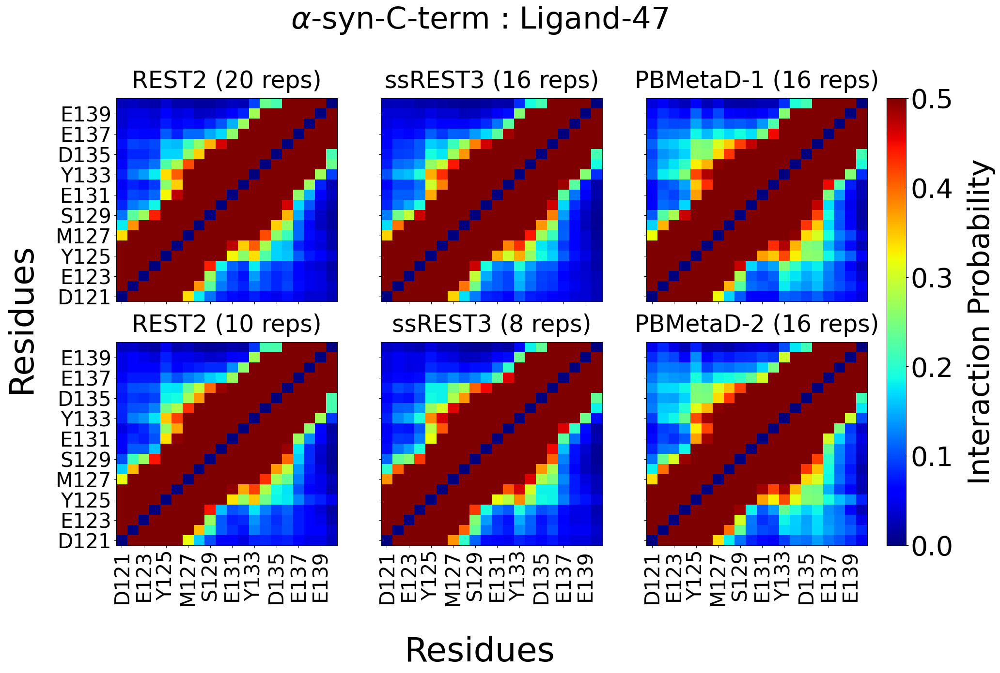

In [ ]:
fig, axes = plt.subplots(2,3, figsize=(20,12), sharex=True, sharey=True)

ax = axes.flatten()

# cax= fig.add_axes([0.93, 0.2, 0.02, 0.6])
# cax = fig.add_axes([axes[2,1].get_position().x1+0.02,axes[2,1].get_position().y0,0.02,axes[0,0].get_position().y1-axes[2,1].get_position().y0])        
# cax = fig.add_axes([axes[2,1].get_position().width-0.24,axes[2,1].get_position().y0-0.09,axes[0,0].get_position().y1-axes[2,1].get_position().y0,0.01])        
cax = fig.add_axes([axes[1,2].get_position().x1+0.02,axes[1,2].get_position().y0,0.02,axes[0,0].get_position().y1-axes[1,2].get_position().y0])        

ax_list={0:0,1:3,2:1,3:4,4:2,5:5} # data_ndx:axes_ndx 

images=[]
for i in range(len(data_dir_f)):
    # ax.set_axis_off()

    if i>=4:
        contact_map = np.array(contact_map_p[i]['0'])
    else:
        contact_map = np.array(contact_map_p[i][f'rep:0'])

    
    # p,q = np.unravel_index(i,(3,2))

    im = ax[ax_list[i]].imshow(contact_map, vmin=0, vmax=0.5,cmap='jet', aspect='auto')
    ax[ax_list[i]].invert_yaxis()
    ax[ax_list[i]].set_xticks(range(0, 20,2), ticks_pnum[::2], rotation=90, size=30)
    ax[ax_list[i]].set_yticks(range(0, 20,2), ticks_pnum[::2], rotation=0, size=30)
    ax[ax_list[i]].grid(False)
    ax[ax_list[i]].set_title(title_[i],size=35, pad=15)

    # if not q : ax[ax_list[i]].set_ylabel("Residues", size=45, labelpad=15)
    # if p == 2-1 : ax[ax_list[i]].set_xlabel('Residues', size=45, labelpad=15)
    images.append(im)

for ax in axes.flat :

    if not bool(ax.has_data()):

        fig.delaxes(ax)

# cbar = fig.colorbar(images[-1],cax=cax, orientation="horizontal")
cbar = fig.colorbar(images[-1],cax=cax)

cbar.set_label("Interaction Probability", size=44, labelpad=20)
cbar.ax.tick_params(labelsize=40)
# cbar.set_ticks([])
# cbar.set_ticklabels([])

fig.text(0.5, -0.09, "Residues", ha="center", fontsize=50)
fig.text(0.01, 0.5, "Residues", va="center", rotation="vertical", fontsize=50)

# plt.suptitle("Protein:protien contact matix",size=50 )
fig.text(0.5, 1, r'$\alpha$-syn-C-term : Ligand-47', ha="center", fontsize=45)

# plt.grid(alpha=0.1)
# plt.tight_layout()
# plt.savefig(f"{out_dir}/p_cm_lig47.png", dpi=1200, bbox_inches='tight')
# plt.savefig(f"{out_dir}/p_cm.pdf", dpi=1200, bbox_inches='tight')
# plt.savefig(f"{out_dir}/p_cm.eps", dpi=1200, bbox_inches='tight')

# plt.show()
# plt.clf()


## Load $K_{d}$ data which gives an insigt into the convergence of the sampling simulations

In [ ]:
# Fasudil 

bf_kd={}
bf={}
kd_time={}


p=0
for i in data_dir_f:
    
    bf_kd[p]=json.load(open(i+'kd.json','r')) # Kd data
    bf[p]=json.load(open(i+'bound_fraction.json','r')) # Bound fraction data
    if p<4 : kd_time[p]=json.load(open(i+'kd_bf_time.json','r')) # Time series data of Kd and bound fraction
    
    p+=1

In [ ]:
np.array(kd_time[0]['rep:0'])[10]

array([8.80070400e-04, 7.49787379e+00, 2.42986651e+01, 2.62022471e+00,
       4.54545455e-01, 2.04545455e-01, 7.04545455e-01])

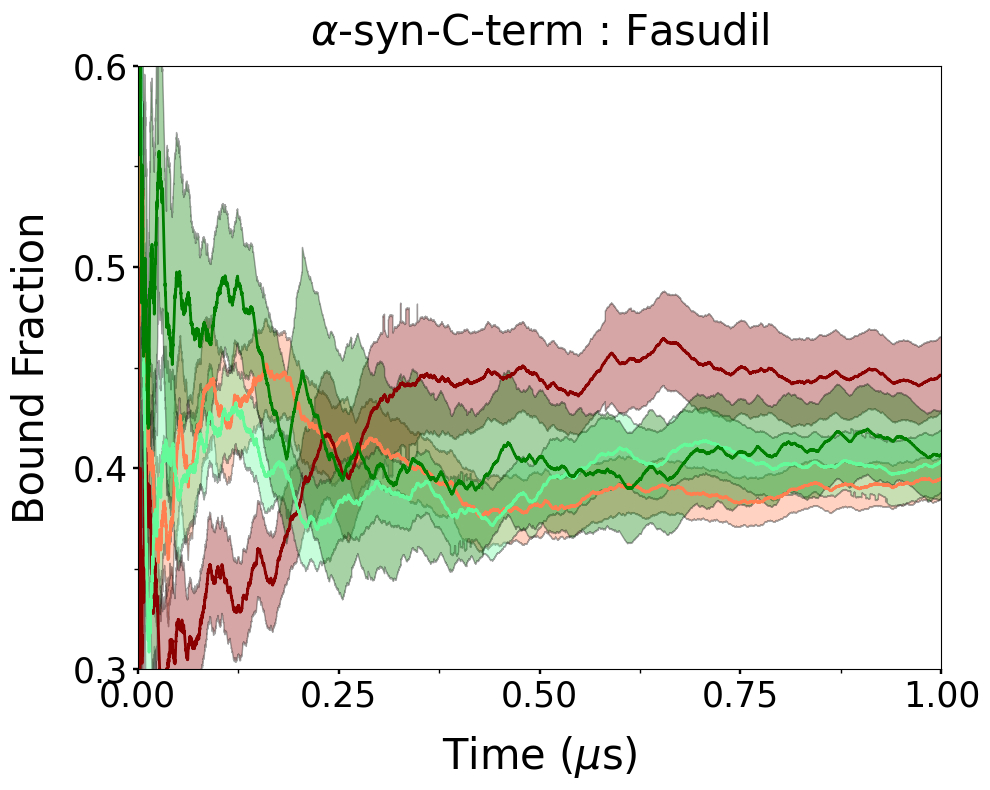

In [ ]:
linestyles = ['-', '--', '-.', ':','dotted']

colors=['coral', 'darkred', '#64FA9A', 'green', 'blue', 'dodgerblue'] # 'mediumspringgreen'
# color_options = ['darkred', 'coral', 'green', 'chartreuse', 'blue', 'dodgerblue']

kd_md={ 'fas' : {'bf' : [0.44124371385214106,0.4184257970329027] , 'bf_e' : [0.015013596379769095,0.01733902439912052]},
       'lig47' : {'bf' : [0.5356228217207661,0.6286623864877809] , 'bf_e' : [0.021208203222481,0.016192229667225704]}}

fig, axes = plt.subplots(1,1,figsize=(10,8))

text_xy = [0.5, 0.3]
temp='BF'

l=len(data_dir_f)-2

for i in range(l):
    
    a=[i for j,i in bf[i].items() if 'rep' in j]
    a=np.array(a)


    axes.plot(np.array(kd_time[i]['rep:0']).T[0][::],np.array(kd_time[i]['rep:0']).T[4][::],
             linestyle=linestyles[i % len(linestyles[0])], color=colors[i], lw=2, ms=7,label=title_[i])
    axes.fill_between(np.array(kd_time[i]['rep:0']).T[0][::], np.array(kd_time[i]['rep:0']).T[5][::],
                np.array(kd_time[i]['rep:0']).T[6][::], color=colors[i], alpha=0.35, edgecolor='black')


    
plt.tick_params(labelsize=25, width=1.75)
plt.rcParams["axes.linewidth"] = 1.75

t=np.arange(0,0.8,0.1).round(1)
plt.xticks(np.arange(0,2.5,0.25))
plt.yticks(t)

plt.xlabel('Time ($\mu$s)', fontsize=30, labelpad=15)
plt.ylim(0.3, 0.6)
plt.xlim(0, 1.0)



# Add minor ticks only on x-axis
plt.gca().xaxis.set_minor_locator(plt.MultipleLocator(0.25/2))
plt.tick_params(axis='x', which='minor', length=3, width=1, color='k', direction='out')
# Add minor ticks only on y-axis
plt.gca().yaxis.set_minor_locator(plt.MultipleLocator(0.1/2))
plt.tick_params(axis='y', which='minor', length=3, width=1, color='k', direction='out')



plt.title(r'$\alpha$-syn-C-term : Fasudil', size=30, pad=15)

# plt.legend(fontsize=18, loc='lower left')
plt.ylabel(f'Bound Fraction', size=30, labelpad=15)
plt.tight_layout()
 
# plt.savefig(f"{out_dir}/bf_time_all_fas.png", dpi=1200, bbox_inches='tight')
# plt.clf()


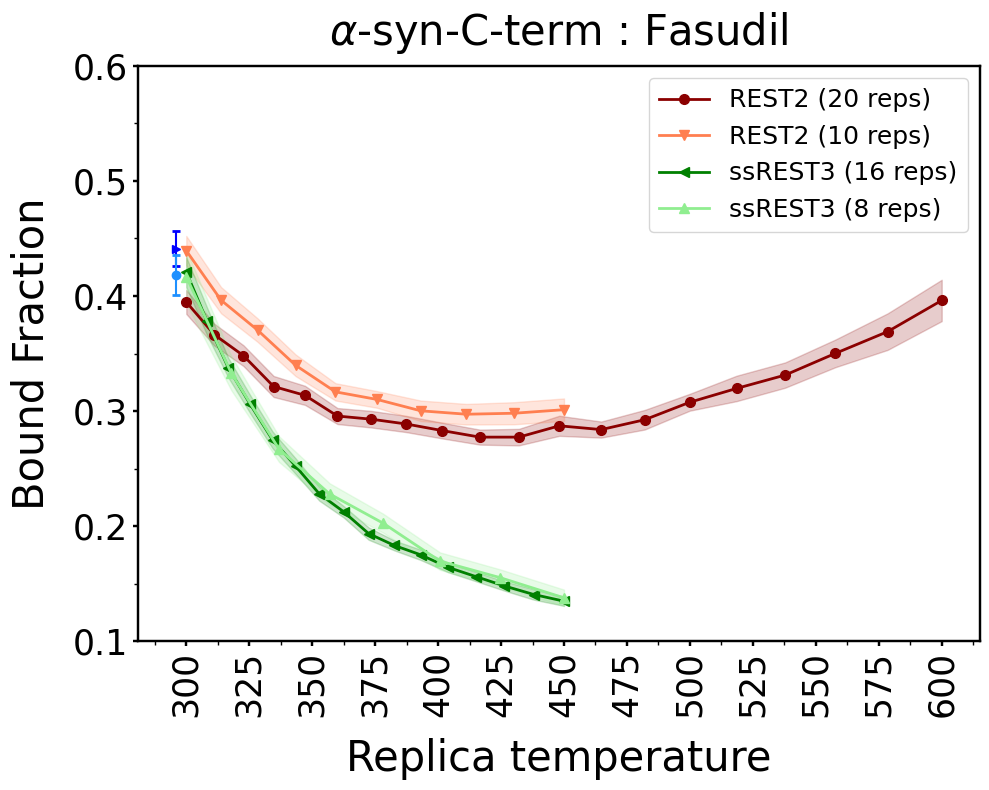

In [ ]:
linestyles = ['-', '--', '-.', ':','dotted']
marker=['o','v','<','^','>']
colors=['darkred', 'coral', 'green', 'lightgreen', 'blue', 'dodgerblue']

plt.figure(figsize=(10,8))
yl=r'Bound Fraction'

l=len(data_dir_f)-2

for i in range(l):
    
    a=[i for j,i in bf[i].items() if 'rep' in j]

    plt.plot(temperature[i],np.array(a).T[0],
                marker=marker[i % len(marker)],color=colors[i % len(colors)], lw=2, ms=7,label=title_[i])
    plt.fill_between(temperature[i], np.array(a).T[0]-np.array(a).T[1],
                np.array(a).T[0]+np.array(a).T[1], color=colors[i % len(colors)], alpha=0.2)

# plt.plot(temperature[0][0]-4, bf[4]['0'][0], color=colors[4 % len(colors)], lw=2, label=title_[4])
plt.errorbar(temperature[0][0]-4, bf[4]['0'][0], yerr=bf[4]['0'][1], fmt=marker[4 % len(marker)],
             color=colors[4 % len(colors)], capsize=3, capthick=2)

# plt.plot(temperature[0][0]-4, bf[5]['0'][0], color=colors[5 % len(colors)], lw=2, label=title_[5])
plt.errorbar(temperature[0][0]-4, bf[5]['0'][0], yerr=bf[5]['0'][1], fmt=marker[5 % len(marker)],
             color=colors[5 % len(colors)], capsize=3, capthick=2)

plt.tick_params(labelsize=15, width=1.75)
plt.rcParams["axes.linewidth"] = 1.75

plt.xticks(range(300,625,25),size=25, rotation=90)
plt.xlabel('Replica temperature', fontsize=30, labelpad=15)
plt.yticks(np.arange(0.1,0.65,0.1), rotation=0, size=25)
# plt.grid(alpha=0.4)
# plt.title("Fasudil", size=35)

# Add minor ticks only on x-axis
plt.gca().xaxis.set_minor_locator(plt.MultipleLocator(25/2))
plt.tick_params(axis='x', which='minor', length=3, width=1, color='k', direction='out')

# Add minor ticks only on y-axis
plt.gca().yaxis.set_minor_locator(plt.MultipleLocator(0.1/2))
plt.tick_params(axis='y', which='minor', length=3, width=1, color='k', direction='out')

plt.legend(fontsize=18, loc='best')    
plt.ylabel(yl, size=30, labelpad=15)

plt.title(r'$\alpha$-syn-C-term : Fasudil', size=30, pad=15)
plt.tight_layout()

# plt.savefig(f"{out_dir}/bf_temp_fas.png", dpi=1200, bbox_inches='tight')
# plt.clf()

In [ ]:
# Ligand 47 

bf_kd={}
bf={}
kd_time={}

p=0
for i in data_dir_l:
    
    bf_kd[p]=json.load(open(i+'kd.json','r')) # Kd data
    bf[p]=json.load(open(i+'bound_fraction.json','r')) # Bound fraction data
    if p<4 : kd_time[p]=json.load(open(i+'kd_bf_time.json','r')) # Time series data of Kd and bound fraction
    p+=1

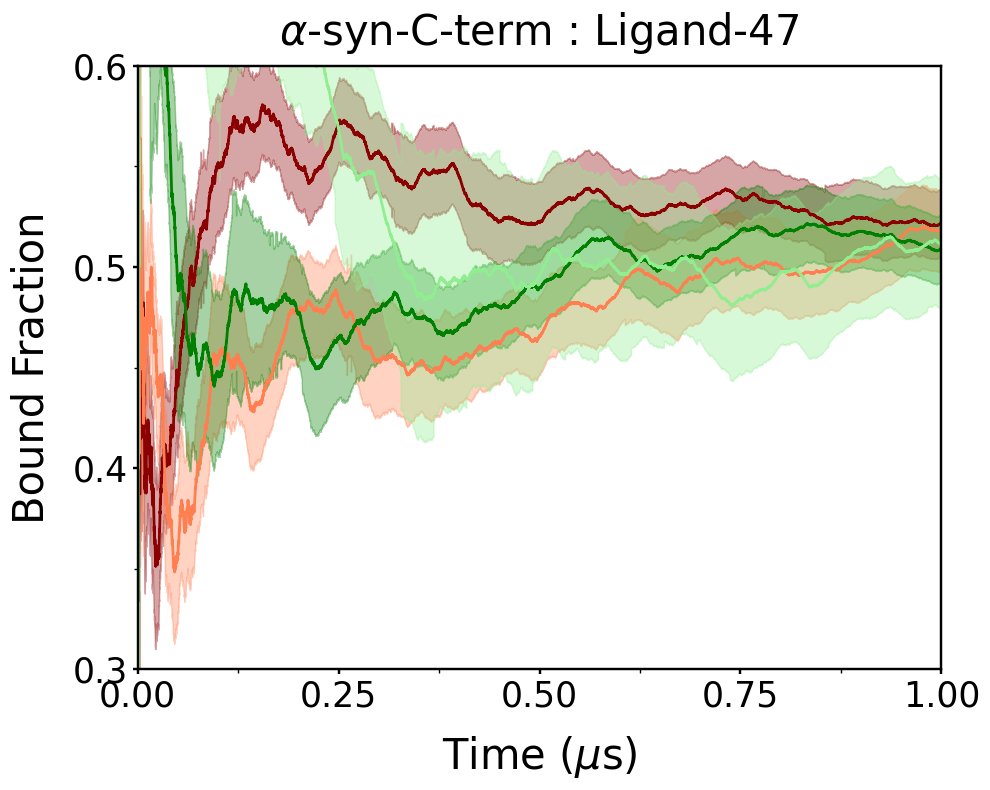

In [ ]:
linestyles = ['-', '--', '-.', ':','dotted']

colors=['darkred', 'coral', 'green', 'lightgreen', 'blue', 'dodgerblue']

kd_md={ 'fas' : {'bf' : [0.44124371385214106,0.4184257970329027] , 'bf_e' : [0.015013596379769095,0.01733902439912052]},
       'lig47' : {'bf' : [0.5356228217207661,0.6286623864877809] , 'bf_e' : [0.021208203222481,0.016192229667225704]}}


fig, axes = plt.subplots(1,1,figsize=(10,8))

text_xy = [0.5, 0.3]
temp='BF'

l=len(data_dir_l)-2

for i in range(l):
    
    a=[i for j,i in bf[i].items() if 'rep' in j]
    a=np.array(a)

  
    axes.plot(np.array(kd_time[i]['rep:0']).T[0][::],np.array(kd_time[i]['rep:0']).T[4][::],
             linestyle=linestyles[i % len(linestyles[0])], color=colors[i], lw=2, ms=7,label=title_[i])
    axes.fill_between(np.array(kd_time[i]['rep:0']).T[0][::], np.array(kd_time[i]['rep:0']).T[5][::],
                np.array(kd_time[i]['rep:0']).T[6][::], color=colors[i], alpha=0.35)

    
plt.tick_params(labelsize=25, width=1.75)
plt.rcParams["axes.linewidth"] = 1.75

t=np.arange(0,0.8,0.1).round(1)
plt.xticks(np.arange(0,2.5,0.25))
plt.yticks(t)

plt.xlabel('Time ($\mu$s)', fontsize=30, labelpad=15)
plt.ylim(0.3, 0.6)
plt.xlim(0, 1.0)



# Add minor ticks only on x-axis
plt.gca().xaxis.set_minor_locator(plt.MultipleLocator(0.25/2))
plt.tick_params(axis='x', which='minor', length=3, width=1, color='k', direction='out')
# Add minor ticks only on y-axis
plt.gca().yaxis.set_minor_locator(plt.MultipleLocator(0.1/2))
plt.tick_params(axis='y', which='minor', length=3, width=1, color='k', direction='out')

func = lambda x, pos: "" if np.isclose(x,0) else x
plt.gca().yaxis.set_major_formatter(matplotlib.ticker.FuncFormatter(func))

plt.title(r'$\alpha$-syn-C-term : Ligand-47', size=30, pad=15)

# plt.legend(fontsize=18, loc='best')
plt.ylabel(f'Bound Fraction', size=30, labelpad=15)
plt.tight_layout()
 
# plt.savefig(f"{out_dir}/bf_time_all_lig47.png", dpi=1200, bbox_inches='tight')
# plt.clf()


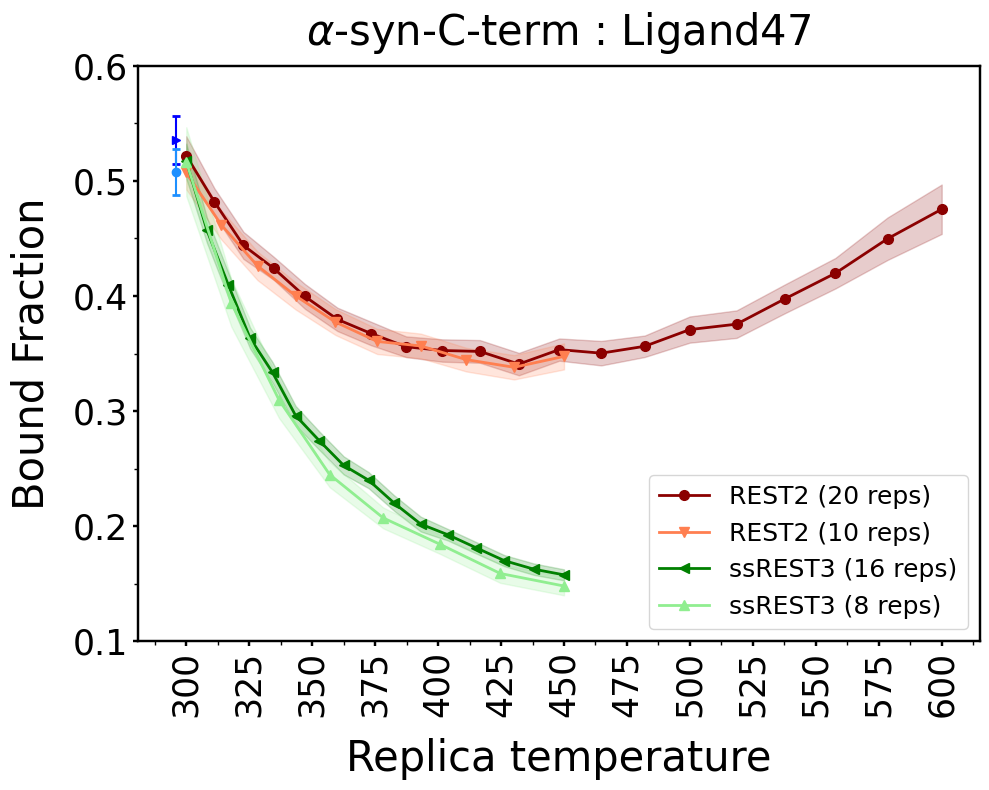

In [ ]:
linestyles = ['-', '--', '-.', ':','dotted']
marker=['o','v','<','^','>']
colors=['darkred', 'coral', 'green', 'lightgreen', 'blue', 'dodgerblue']

plt.figure(figsize=(10,8))
yl=r'Bound Fraction'

l=len(data_dir_f)-2

for i in range(l):
    
    a=[i for j,i in bf[i].items() if 'rep' in j]

    plt.plot(temperature[i],np.array(a).T[0],
                marker=marker[i % len(marker)],color=colors[i % len(colors)], lw=2, ms=7,label=title_[i])
    plt.fill_between(temperature[i], np.array(a).T[0]-np.array(a).T[1],
                np.array(a).T[0]+np.array(a).T[1], color=colors[i % len(colors)], alpha=0.2)

# plt.plot(temperature[0][0]-4, bf[4]['0'][0], color=colors[4 % len(colors)], lw=2, label=title_[4])
plt.errorbar(temperature[0][0]-4, bf[4]['0'][0], yerr=bf[4]['0'][1], fmt=marker[4 % len(marker)],
             color=colors[4 % len(colors)], capsize=3, capthick=2)

# plt.plot(temperature[0][0]-4, bf[5]['0'][0], color=colors[5 % len(colors)], lw=2, label=title_[5])
plt.errorbar(temperature[0][0]-4, bf[5]['0'][0], yerr=bf[5]['0'][1], fmt=marker[5 % len(marker)],
             color=colors[5 % len(colors)], capsize=3, capthick=2)

plt.tick_params(labelsize=15, width=1.75)
plt.rcParams["axes.linewidth"] = 1.75

plt.xticks(range(300,625,25),size=25, rotation=90)
plt.xlabel('Replica temperature', fontsize=30, labelpad=15)
plt.yticks(np.arange(0.1,0.65,0.1), rotation=0, size=25)
# plt.grid(alpha=0.4)
# plt.title("Fasudil", size=35)

# Add minor ticks only on x-axis
plt.gca().xaxis.set_minor_locator(plt.MultipleLocator(25/2))
plt.tick_params(axis='x', which='minor', length=3, width=1, color='k', direction='out')

# Add minor ticks only on y-axis
plt.gca().yaxis.set_minor_locator(plt.MultipleLocator(0.1/2))
plt.tick_params(axis='y', which='minor', length=3, width=1, color='k', direction='out')

plt.legend(fontsize=18, loc='best')    
plt.ylabel(yl, size=30, labelpad=15)

plt.title(r'$\alpha$-syn-C-term : Ligand47', size=30, pad=15)
plt.tight_layout()

# plt.savefig(f"{out_dir}/bf_temp_lif47.png", dpi=1200, bbox_inches='tight')
# plt.clf()

In [ ]:
data_dir_f

array(['/data/jk_ssREST3_repo_data/data//REST2/data_fas_20/',
       '/data/jk_ssREST3_repo_data/data//REST2/data_fas_10/',
       '/data/jk_ssREST3_repo_data/data//ssREST3/data_fas_16/',
       '/data/jk_ssREST3_repo_data/data//ssREST3/data_fas_8/',
       '/data/jk_ssREST3_repo_data/data//PBMetaD//fas_1/data/out_0/',
       '/data/jk_ssREST3_repo_data/data//PBMetaD//fas_2/data/out_0/'],
      dtype='<U59')

## Add the Kd_aggregate time data and plots

In [ ]:
def reposition_first(array):
    import numpy as np
    if len(array.shape) == 2:  # Check if it's 2D
        # Reposition first row to the last
        return np.vstack((array[1:], array[0]))
    elif len(array.shape) == 3:  # Check if it's 3D
        # Reposition first slice to the last
        return np.concatenate((array[1:], array[:1]), axis=0)

In [ ]:
# agg_cm_fas = json.load(open(f'/Users/jayakrishnakoneru/Documents/work/plots_now/REST_DATA/aggregate_data/fas_agg_cm.json','r'))
# agg_cm_lig47 = json.load(open(f'/Users/jayakrishnakoneru/Documents/work/plots_now/REST_DATA/aggregate_data/lig47_agg_cm.json','r'))
agg_bf_fas={}
time_series_fas={}

for i in range(len(data_dir_f)-2):
    agg_bf_fas[i] = json.load(open(f'{data_dir_f[i]}/agreegate_kd_bf.json','r'))
    time_series_fas[i] = [float(j) for j in agg_bf_fas[i].keys()] # Time series data of Kd and bound fraction
    agg_bf_fas[i] = [agg_bf_fas[i][j] for j in agg_bf_fas[i].keys()]
# agg_kd_lig47 = json.load(open(f'/Users/jayakrishnakoneru/Documents/work/plots_now/REST_DATA/aggregate_data/lig47_agg_kd.json','r'))


In [ ]:
pbmd_directory =  f'{w_dir}/PBMetaD/'

a = [f'{i}' for i in ['fas_1', 'fas_2', 'lig47_1', 'lig47_2']]

# data_dir = [f'{pbmd_directory}/{a}/data/out_{i}/' for i in range(0, 1000, 100)]

file_name = 'bound_fraction.json'

bf_fas_1 = []
bf_fas_2 = []
bf_lig47_1 = []
bf_lig47_2 = []

for i in range(0, 1000, 100):
    bf_fas_1.append(load_json(f'{pbmd_directory}/{a[0]}/data/out_{i}/{file_name}'))
    bf_fas_2.append(load_json(f'{pbmd_directory}/{a[1]}/data/out_{i}/{file_name}'))
    bf_lig47_1.append(load_json(f'{pbmd_directory}/{a[2]}/data/out_{i}/{file_name}'))
    bf_lig47_2.append(load_json(f'{pbmd_directory}/{a[3]}/data/out_{i}/{file_name}'))

bf_fas_1 = np.array([bf_fas_1[i]['0'] for i in range(len(bf_fas_1))])
bf_fas_1 = reposition_first(bf_fas_1)

bf_fas_2 = np.array([bf_fas_2[i]['0'] for i in range(len(bf_fas_2))])
bf_fas_2 = reposition_first(bf_fas_2)

bf_lig47_1 = np.array([bf_lig47_1[i]['0'] for i in range(len(bf_lig47_1))])
bf_lig47_1 = reposition_first(bf_lig47_1)

bf_lig47_2 = np.array([bf_lig47_2[i]['0'] for i in range(len(bf_lig47_2))])
bf_lig47_2 = reposition_first(bf_lig47_2)

bf_all = np.stack((bf_fas_1, bf_fas_2, bf_lig47_1, bf_lig47_2), axis=0)

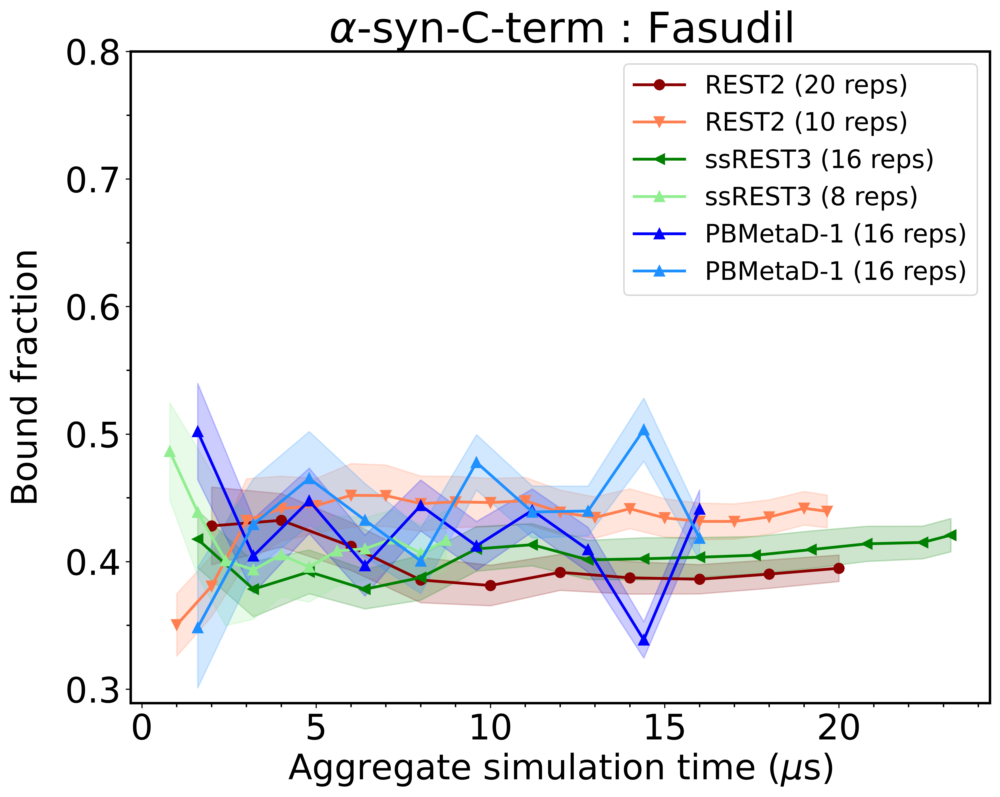

In [50]:
linestyles = ['-', '--', '-.', ':','dotted']
marker=['o','v','<','^','>']
colors=['darkred', 'coral', 'green', 'lightgreen', 'blue', 'dodgerblue']

plt.figure(figsize=(10,8), dpi=610)
yl=r'Bound fraction'
a=4

for i in range(a):
    
    # x=[a[1]*nrep[i]/10**3 for a in agg_bf_fas[i].keys() if i in a  ]
    # x=[int(a.split(':')[1])*nrep[i]/10**3 for a in agg_bf_fas[i].keys() if int(a.split(':')[0])==i]
    x = [float(a)*nrep[i]/10**3 for a in time_series_fas[i]]

    plt.plot(x,np.array(agg_bf_fas[i]).T[0],
             marker=marker[i % len(marker)],color=colors[i % len(colors)], lw=2, ms=7,label=title_[i])
    plt.fill_between(x, np.array(agg_bf_fas[i]).T[0] - np.array(agg_bf_fas[i]).T[1],
                     np.array(agg_bf_fas[i]).T[0] + np.array(agg_bf_fas[i]).T[1], color=colors[i % len(colors)], alpha=0.2)

plt.plot([round((i/1000)*16, 1) for i in range(100,1100,100)],bf_all[0].T[0],  color='blue', lw=2, marker=marker[i % 5], ms=7, label=title_[4])
# plt.errorbar([round((i/1000)*16, 1) for i in range(100,1100,100)],bf_all[0].T[0], yerr=bf_all[0].T[1], fmt='o', color='blue', capsize=2)
plt.fill_between([round((i/1000)*16, 1) for i in range(100,1100,100)], bf_all[0].T[0]-bf_all[0].T[1], bf_all[0].T[0]+bf_all[0].T[1], color='blue', alpha=0.2)

plt.plot([round((i/1000)*16, 1) for i in range(100,1100,100)],bf_all[1].T[0],  color='dodgerblue', lw=2, marker=marker[i % 5], ms=7, label=title_[4])
# plt.errorbar([round((i/1000)*16, 1) for i in range(100,1100,100)],bf_all[1].T[0], yerr=bf_all[1].T[1], fmt='o', color='dodgerblue', capsize=2)
plt.fill_between([round((i/1000)*16, 1) for i in range(100,1100,100)], bf_all[1].T[0]-bf_all[1].T[1], bf_all[1].T[0]+bf_all[1].T[1], color='dodgerblue', alpha=0.2)

plt.tick_params(labelsize=25)
# plt.xticks(range(100,1100,100))
plt.xlabel('Aggregate simulation time ($\mu$s)', fontsize=25)
plt.yticks(np.arange(0.3,0.85,0.1), rotation=0, size=25)
# plt.grid(alpha=0.4)
plt.title(r'$\alpha$-syn-C-term : Fasudil', size=30)

#Add minor ticks only on x-axis
plt.gca().xaxis.set_minor_locator(plt.MultipleLocator(1))
plt.tick_params(axis='x', which='minor', length=3, width=1, color='k', direction='out')

#Add minor ticks only on y-axis
plt.gca().yaxis.set_minor_locator(plt.MultipleLocator(0.05))
plt.tick_params(axis='y', which='minor', length=3, width=1, color='k', direction='out')

plt.legend(fontsize=18)    
plt.ylabel(yl, size=25, labelpad=15)
plt.tight_layout()

# plt.savefig(f"/home/jaya/work/plots_now/temp_data/lig47/bf_v_time.png", dpi=310, bbox_inches='tight')
# plt.savefig(f"{out_dir}/bf_v_time_fas.png", dpi=1200, bbox_inches='tight')

# plt.show()
# plt.clf()

In [51]:
# agg_cm_lig47 = json.load(open(f'/Users/jayakrishnakoneru/Documents/work/plots_now/REST_DATA/aggregate_data/fas_agg_cm.json','r'))
# agg_cm_lig47 = json.load(open(f'/Users/jayakrishnakoneru/Documents/work/plots_now/REST_DATA/aggregate_data/lig47_agg_cm.json','r'))
agg_bf_lig47={}
time_series_lig47={}

for i in range(len(data_dir_l)-2):
    agg_bf_lig47[i] = json.load(open(f'{data_dir_l[i]}/agreegate_kd_bf.json','r'))
    time_series_lig47[i] = [float(j) for j in agg_bf_lig47[i].keys()] # Time series data of Kd and bound fraction
    agg_bf_lig47[i] = [agg_bf_lig47[i][j] for j in agg_bf_lig47[i].keys()]
# agg_kd_lig47 = json.load(open(f'/Users/jayakrishnakoneru/Documents/work/plots_now/REST_DATA/aggregate_data/lig47_agg_kd.json','r'))


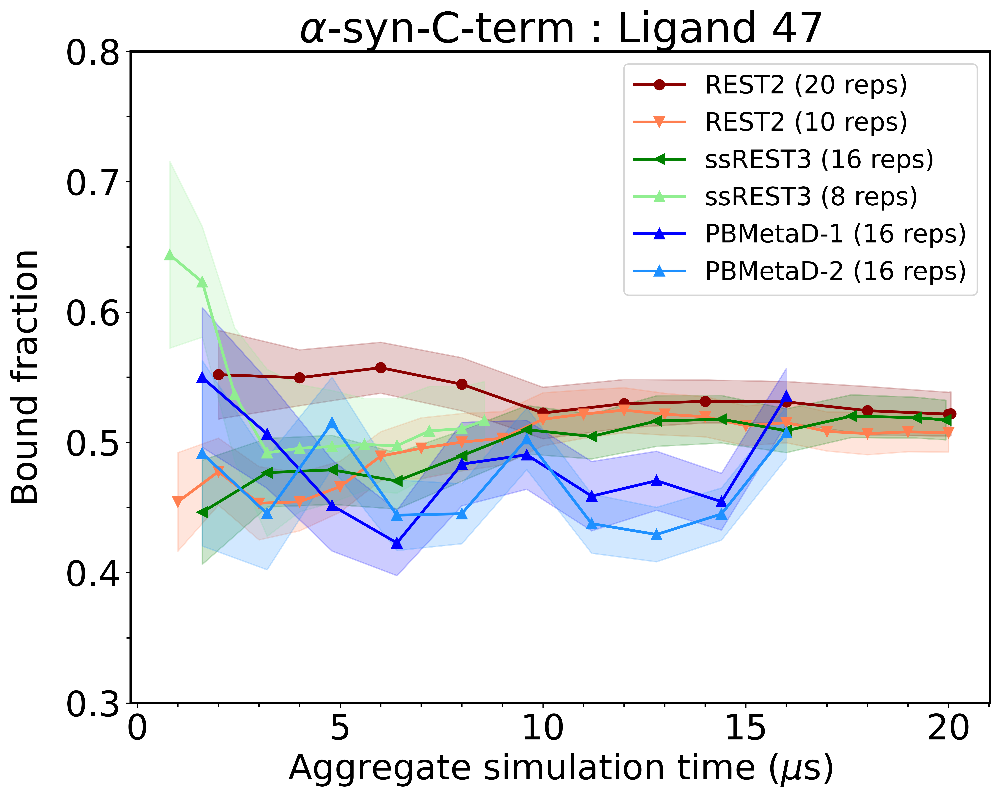

In [52]:
linestyles = ['-', '--', '-.', ':','dotted']
marker=['o','v','<','^','>']
colors=['darkred', 'coral', 'green', 'lightgreen', 'blue', 'dodgerblue']

plt.figure(figsize=(10,8), dpi=610)
yl=r'Bound fraction'
a=4

for i in range(a):
    
    # x=[a[1]*nrep[i]/10**3 for a in agg_cm_lig47.keys() if i in a  ]
    # x=[int(a.split(':')[1])*nrep[i]/10**3 for a in agg_cm_lig47.keys() if int(a.split(':')[0])==i]
    x = [float(a)*nrep[i]/10**3 for a in time_series_lig47[i]]

    plt.plot(x,np.array(agg_bf_lig47[i]).T[0],
             marker=marker[i % len(marker)],color=colors[i % len(colors)], lw=2, ms=7,label=title_[i])
    plt.fill_between(x, np.array(agg_bf_lig47[i]).T[0]-np.array(agg_bf_lig47[i]).T[1],
                     np.array(agg_bf_lig47[i]).T[0]+np.array(agg_bf_lig47[i]).T[1], color=colors[i % len(colors)], alpha=0.2)

plt.plot([round((i/1000)*16, 1) for i in range(100,1100,100)],bf_all[2].T[0],  color='blue', lw=2, marker=marker[i % 5], ms=7, label=title_[4])
# plt.errorbar([round((i/1000)*16, 1) for i in range(100,1100,100)],bf_all[2].T[0], yerr=bf_all[2].T[1], fmt='o', color='blue', capsize=2)
plt.fill_between([round((i/1000)*16, 1) for i in range(100,1100,100)], bf_all[2].T[0]-bf_all[2].T[1], bf_all[2].T[0]+bf_all[2].T[1], color='blue', alpha=0.2)

plt.plot([round((i/1000)*16, 1) for i in range(100,1100,100)],bf_all[3].T[0],  color='dodgerblue', lw=2, marker=marker[i % 5], ms=7, label=title_[5])
# plt.errorbar([round((i/1000)*16, 1) for i in range(100,1100,100)],bf_all[3].T[0], yerr=bf_all[3].T[1], fmt='o', color='dodgerblue', capsize=2)
plt.fill_between([round((i/1000)*16, 1) for i in range(100,1100,100)], bf_all[3].T[0]-bf_all[3].T[1], bf_all[3].T[0]+bf_all[3].T[1], color='dodgerblue', alpha=0.2)

plt.tick_params(labelsize=25)
# plt.xticks(range(100,1100,100))
plt.xlabel('Aggregate simulation time ($\mu$s)', fontsize=25)
plt.yticks(np.arange(0.3,0.85,0.1), rotation=0, size=25)
# plt.grid(alpha=0.4)
plt.title(r'$\alpha$-syn-C-term : Ligand 47', size=30)

#Add minor ticks only on x-axis
plt.gca().xaxis.set_minor_locator(plt.MultipleLocator(1))
plt.tick_params(axis='x', which='minor', length=3, width=1, color='k', direction='out')

#Add minor ticks only on y-axis
plt.gca().yaxis.set_minor_locator(plt.MultipleLocator(0.05))
plt.tick_params(axis='y', which='minor', length=3, width=1, color='k', direction='out')

plt.legend(fontsize=18)    
plt.ylabel(yl, size=25, labelpad=15)
plt.tight_layout()

# plt.savefig(f"/home/jaya/work/plots_now/temp_data/lig47/bf_v_time.png", dpi=310, bbox_inches='tight')
# plt.savefig(f"{out_dir}/bf_v_time_lig47.png", dpi=1200, bbox_inches='tight')

# plt.show()
# plt.clf()

## Load protein:ligand contact modes data

## Fasudil

In [53]:
# Fasudil

charge={}
hphob={}
aro={}
hbond={}

p=0
for i in data_dir_f:
    
    if p>=4 : 
        
        charge[p]=json.load(open(i+'charge_re.json','r'))
        hphob[p]=json.load(open(i+'hyphob_interactions_re.json','r'))
        aro[p]=json.load(open(i+'aro_interactions_re.json','r'))
        hbond[p]=json.load(open(i+'hbond_interactions_re.json','r'))
        
    else :
        
        charge[p]=json.load(open(i+'charge_contact_fraction.json','r'))
        hphob[p]=json.load(open(i+'hyphob_interactions.json','r'))
        aro[p]=json.load(open(i+'aro_interactions.json','r'))
        hbond[p]=json.load(open(i+'hbond_interactions.json','r'))
    
    p+=1

bf_kd={}
bf={}

p=0
for i in data_dir_f:
    
    bf_kd[p]=json.load(open(i+'kd.json','r'))
    bf[p]=json.load(open(i+'bound_fraction.json','r'))


    p+=1

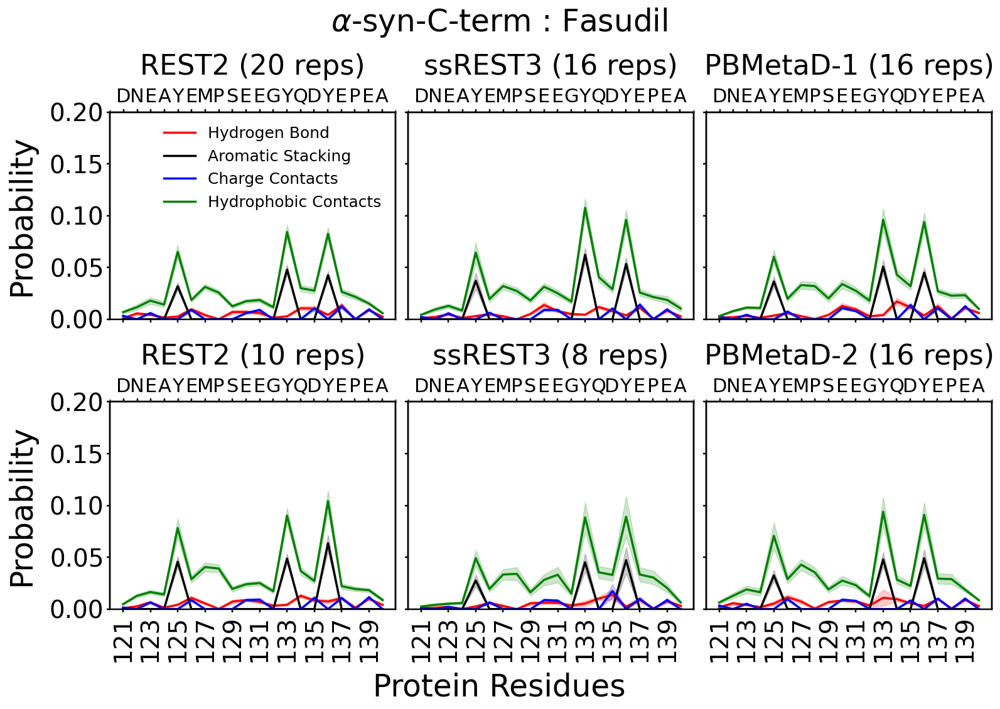

In [54]:
fig, axes = plt.subplots(2,3 , figsize=(16, 10), sharex=True, sharey=True)

ax = axes.flatten()

i='rep'
val=0
l=0

ax_list={0:0,1:3,2:1,3:4,4:2,5:5} # data_ndx:axes_ndx

for j in range(len(data_dir_f)):
    
    # ax_list[j] = np.unravel_index(j,(2,3))
    
        
    if ax_list[j]==2 or ax_list[j]==5:
        
        ax[ax_list[j]].plot(np.array(hbond[l]['0']).T[0], np.array(hbond[l]['0']).T[1], linewidth=2.5,
                             label='Hydrogen Bond', color='red')
        ax[ax_list[j]].fill_between(np.array(hbond[l]['0']).T[0], np.array(hbond[l]['0']).T[1]-np.array(hbond[l]['0']).T[2],
                                 np.array(hbond[l]['0']).T[1]+np.array(hbond[l]['0']).T[2], alpha=0.2,color='r')


        ax[ax_list[j]].plot(np.array(aro[l]['0']).T[0], np.array(aro[l]['0']).T[1], linewidth=2.5,
                             color='black', label='Aromatic Stacking')
        ax[ax_list[j]].fill_between(np.array(aro[l]['0']).T[0], np.array(aro[l]['0']).T[1]-np.array(aro[l]['0']).T[2],
                                 np.array(aro[l]['0']).T[1]+np.array(aro[l]['0']).T[2], alpha=0.2,color='black')

        ax[ax_list[j]].plot(np.array(charge[l]['0']).T[0], np.array(charge[l]['0']).T[1], linewidth=2.5,
                             label='Charge Contacts',c='blue')
        ax[ax_list[j]].fill_between(np.array(charge[l]['0']).T[0], np.array(charge[l]['0']).T[1]-np.array(charge[l]['0']).T[2],
                                 np.array(charge[l]['0']).T[1]+np.array(charge[l]['0']).T[2], alpha=0.2,color='b')

        ax[ax_list[j]].plot(np.array(hphob[l]['0']).T[0], np.array(hphob[l]['0']).T[1], linewidth=2.5,
                             label='Hydrophobic Contacts', color='green')
        ax[ax_list[j]].fill_between(np.array(hphob[l]['0']).T[0], np.array(hphob[l]['0']).T[1]-np.array(hphob[l]['0']).T[2],
                                 np.array(hphob[l]['0']).T[1]+np.array(hphob[l]['0']).T[2], alpha=0.2,color='g')
        
        
        ax[ax_list[j]].set_ylim(0,0.2)
        ax[ax_list[j]].set_xticks(range(121,141,2), range(121,141,2))
        ax[ax_list[j]].tick_params(labelsize=28, width=1.75)
        plt.rcParams["axes.linewidth"] = 1.75

        # ax[ax_list[j]].grid(alpha=0.4)
        plt.setp(ax[ax_list[j]].get_xticklabels(), rotation=90)


        # ax[ax_list[j]].annotate("", xy=(125, 0.085), xytext=(125, 0.125),
        # arrowprops={"arrowstyle":'->', "lw":4, "color":"k"},
        # horizontalalignment='center',fontsize=15, rotation=45)
        # ax[ax_list[j]].annotate("", xy=(133, 0.12), xytext=(133, 0.16),
        # arrowprops={"arrowstyle":'->', "lw":4, "color":"k"},
        # horizontalalignment='center',fontsize=15, rotation=45)
        # ax[ax_list[j]].annotate("", xy=(136, 0.12), xytext=(136, 0.16),
        # arrowprops={"arrowstyle":'->', "lw":4, "color":"k"},
        # horizontalalignment='center',fontsize=15, rotation=45)

        a=title_[j]
        ax[ax_list[j]].set_title(a,size=32, pad=15)

        ax2 = ax[ax_list[j]].twiny()



        # Use invisible spines and set labels for the top x-axis
        ax2.spines['top'].set_position(('outward', 0))
        ax2.spines['top'].set_visible(True)
        ax2.spines['bottom'].set_position(('outward', 0))
        ax2.spines['bottom'].set_visible(False)
        ax2.set_xlim(120,141)
        ax2.set_xticks(range(121,141), ticks_pname[::])
        # ax2.set_xticklabels(top_labels)
        ax2.tick_params(axis='x', labelsize=22, width=1.75)
        plt.gca().xaxis.set_minor_locator(plt.MultipleLocator(1))
        ax2.tick_params(axis='x', which='minor', length=3, width=1, color='k', direction='out')
        

        
    else:
        
        akd=[i for j,i in bf[j].items() if 'rep' in j]
        akd=np.array(akd)

        ax[ax_list[j]].plot(np.array(hbond[j][f'{i}:{val}']).T[0], np.array(hbond[j][f'{i}:{val}']).T[1], linewidth=2.5,
                             label='Hydrogen Bond', color='red')
        ax[ax_list[j]].fill_between(np.array(hbond[j][f'{i}:{val}']).T[0], np.array(hbond[j][f'{i}:{val}']).T[1]-np.array(hbond[j][f'{i}:{val}']).T[2],
                                 np.array(hbond[j][f'{i}:{val}']).T[1]+np.array(hbond[j][f'{i}:{val}']).T[2], alpha=0.2,color='r')


        ax[ax_list[j]].plot(np.array(aro[j][f'{i}:{val}']).T[0], np.array(aro[j][f'{i}:{val}']).T[1], linewidth=2.5,
                             color='black', label='Aromatic Stacking')
        ax[ax_list[j]].fill_between(np.array(aro[j][f'{i}:{val}']).T[0], np.array(aro[j][f'{i}:{val}']).T[1]-np.array(aro[j][f'{i}:{val}']).T[2],
                                 np.array(aro[j][f'{i}:{val}']).T[1]+np.array(aro[j][f'{i}:{val}']).T[2], alpha=0.2,color='black')

        ax[ax_list[j]].plot(np.array(charge[j][f'{i}:{val}']).T[0], np.array(charge[j][f'{i}:{val}']).T[1], linewidth=2.5,
                             label='Charge Contacts',c='blue')
        ax[ax_list[j]].fill_between(np.array(charge[j][f'{i}:{val}']).T[0], np.array(charge[j][f'{i}:{val}']).T[1]-np.array(charge[j][f'{i}:{val}']).T[2],
                                 np.array(charge[j][f'{i}:{val}']).T[1]+np.array(charge[j][f'{i}:{val}']).T[2], alpha=0.2,color='b')

        ax[ax_list[j]].plot(np.array(hphob[j][f'{i}:{val}']).T[0], np.array(hphob[j][f'{i}:{val}']).T[1], linewidth=2.5,
                             label='Hydrophobic Contacts', color='green')
        ax[ax_list[j]].fill_between(np.array(hphob[j][f'{i}:{val}']).T[0], np.array(hphob[j][f'{i}:{val}']).T[1]-np.array(hphob[j][f'{i}:{val}']).T[2],
                                 np.array(hphob[j][f'{i}:{val}']).T[1]+np.array(hphob[j][f'{i}:{val}']).T[2], alpha=0.2,color='g')
    
    
        
        ax[ax_list[j]].set_ylim(0,0.2)
        ax[ax_list[j]].set_xticks(range(121,141,2), range(121,141,2))
        ax[ax_list[j]].tick_params(labelsize=28, width=1.75)
        plt.rcParams["axes.linewidth"] = 1.75

        # ax[ax_list[j]].grid(alpha=0.4)
        plt.setp(ax[ax_list[j]].get_xticklabels(), rotation=90)

        # ax[ax_list[j]].annotate("", xy=(125, 0.085), xytext=(125, 0.125),
        # arrowprops={"arrowstyle":'->', "lw":4, "color":"k"},
        # horizontalalignment='center',fontsize=15, rotation=45)
        # ax[ax_list[j]].annotate("", xy=(133, 0.12), xytext=(133, 0.16),
        # arrowprops={"arrowstyle":'->', "lw":4, "color":"k"},
        # horizontalalignment='center',fontsize=15, rotation=45)
        # ax[ax_list[j]].annotate("", xy=(136, 0.12), xytext=(136, 0.16),
        # arrowprops={"arrowstyle":'->', "lw":4, "color":"k"},
        # horizontalalignment='center',fontsize=15, rotation=45,)

        if j == 0:
            ax[ax_list[j]].legend(loc=1,prop={'size': 18}, frameon=False)
            
        a=title_[j]
        ax[ax_list[j]].set_title(a,size=32, pad=15)

        ax2 = ax[ax_list[j]].twiny()


        # Use invisible spines and set labels for the top x-axis
        ax2.spines['top'].set_position(('outward', 0))
        ax2.spines['top'].set_visible(True)
        ax2.spines['bottom'].set_position(('outward', 0))
        ax2.spines['bottom'].set_visible(False)
        ax2.set_xlim(120,141)
        ax2.set_xticks(range(121,141), ticks_pname[::])
        # ax2.set_xticklabels(top_labels)
        ax2.tick_params(axis='x', labelsize=22, width=1.75)
        plt.gca().xaxis.set_minor_locator(plt.MultipleLocator(1))
        ax2.tick_params(axis='x', which='minor', length=3, width=1, color='k', direction='out')
        

            
    l+=1
        
        
    if ax_list[j]==0 or ax_list[j]==3 : ax[ax_list[j]].set_ylabel("Probability", size=35, labelpad=15)

fig.text(0.5, -0.04, "Protein Residues", ha='center', size=35)

fig.text(0.5, 1.02, r'$\alpha$-syn-C-term : Fasudil', ha="center", fontsize=35)

plt.tight_layout()
plt.savefig(f"{out_dir}/all_ligand_contacts_fas.png", dpi=1200, bbox_inches='tight')
plt.savefig(f"{out_dir}/all_ligand_contacts_fas.pdf", dpi=1200, bbox_inches='tight')
# plt.savefig(f"{out_dir}/all_ligand_contacts.eps", dpi=1200, bbox_inches='tight')


# plt.clf()

## Ligand 47

In [55]:
# Ligand 47

charge={}
hphob={}
aro={}
hbond={}

p=0
for i in data_dir_l:
    
    if p>=4 : 
        
        charge[p]=json.load(open(i+'charge_re.json','r'))
        hphob[p]=json.load(open(i+'hyphob_interactions_re.json','r'))
        aro[p]=json.load(open(i+'aro_interactions_re.json','r'))
        hbond[p]=json.load(open(i+'hbond_interactions_re.json','r'))
        
    else :
        
        charge[p]=json.load(open(i+'charge_contact_fraction.json','r'))
        hphob[p]=json.load(open(i+'hyphob_interactions.json','r'))
        aro[p]=json.load(open(i+'aro_interactions.json','r'))
        hbond[p]=json.load(open(i+'hbond_interactions.json','r'))
    
    p+=1

bf_kd={}
bf={}

p=0
for i in data_dir_l:
    
    bf_kd[p]=json.load(open(i+'kd.json','r'))
    bf[p]=json.load(open(i+'bound_fraction.json','r'))


    p+=1

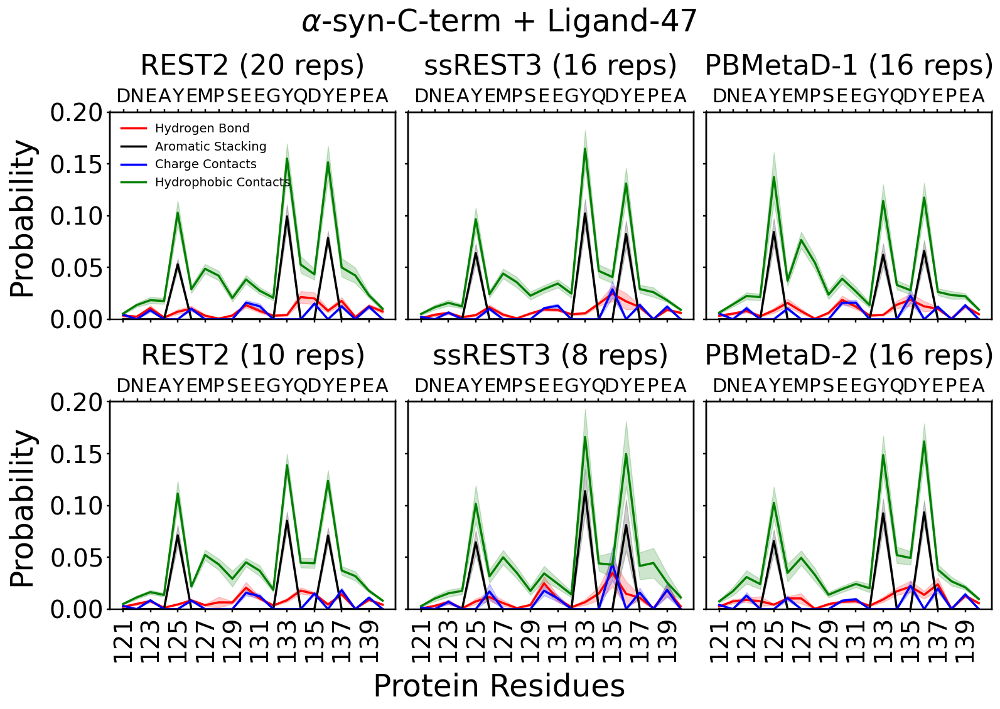

In [56]:
fig, axes = plt.subplots(2,3 , figsize=(16, 10), sharex=True, sharey=True)

ax = axes.flatten()

i='rep'
val=0
l=0

ax_list={0:0,1:3,2:1,3:4,4:2,5:5} # data_ndx:axes_ndx

for j in range(len(data_dir_f)):
    
    # ax_list[j] = np.unravel_index(j,(2,3))
    
        
    if ax_list[j]==2 or ax_list[j]==5:
        
        ax[ax_list[j]].plot(np.array(hbond[l]['0']).T[0], np.array(hbond[l]['0']).T[1], linewidth=2.5,
                             label='Hydrogen Bond', color='red')
        ax[ax_list[j]].fill_between(np.array(hbond[l]['0']).T[0], np.array(hbond[l]['0']).T[1]-np.array(hbond[l]['0']).T[2],
                                 np.array(hbond[l]['0']).T[1]+np.array(hbond[l]['0']).T[2], alpha=0.2,color='r')


        ax[ax_list[j]].plot(np.array(aro[l]['0']).T[0], np.array(aro[l]['0']).T[1], linewidth=2.5,
                             color='black', label='Aromatic Stacking')
        ax[ax_list[j]].fill_between(np.array(aro[l]['0']).T[0], np.array(aro[l]['0']).T[1]-np.array(aro[l]['0']).T[2],
                                 np.array(aro[l]['0']).T[1]+np.array(aro[l]['0']).T[2], alpha=0.2,color='black')

        ax[ax_list[j]].plot(np.array(charge[l]['0']).T[0], np.array(charge[l]['0']).T[1], linewidth=2.5,
                             label='Charge Contacts',c='blue')
        ax[ax_list[j]].fill_between(np.array(charge[l]['0']).T[0], np.array(charge[l]['0']).T[1]-np.array(charge[l]['0']).T[2],
                                 np.array(charge[l]['0']).T[1]+np.array(charge[l]['0']).T[2], alpha=0.2,color='b')

        ax[ax_list[j]].plot(np.array(hphob[l]['0']).T[0], np.array(hphob[l]['0']).T[1], linewidth=2.5,
                             label='Hydrophobic Contacts', color='green')
        ax[ax_list[j]].fill_between(np.array(hphob[l]['0']).T[0], np.array(hphob[l]['0']).T[1]-np.array(hphob[l]['0']).T[2],
                                 np.array(hphob[l]['0']).T[1]+np.array(hphob[l]['0']).T[2], alpha=0.2,color='g')
        
        
        ax[ax_list[j]].set_ylim(0,0.2)
        ax[ax_list[j]].set_xticks(range(121,141,2), range(121,141,2))
        ax[ax_list[j]].tick_params(labelsize=28, width=1.75)
        plt.rcParams["axes.linewidth"] = 1.75

        # ax[ax_list[j]].grid(alpha=0.4)
        plt.setp(ax[ax_list[j]].get_xticklabels(), rotation=90)


        # if ax_list[j] == 5:
        #     ax[ax_list[j]].legend(bbox_to_anchor=(1,1.5),prop={'size': 24}, frameon=False)


        a=title_[j]
        ax[ax_list[j]].set_title(a,size=32, pad=15)

        ax2 = ax[ax_list[j]].twiny()



        # Use invisible spines and set labels for the top x-axis
        ax2.spines['top'].set_position(('outward', 0))
        ax2.spines['top'].set_visible(True)
        ax2.spines['bottom'].set_position(('outward', 0))
        ax2.spines['bottom'].set_visible(False)
        ax2.set_xlim(120,141)
        ax2.set_xticks(range(121,141), ticks_pname[::])
        # ax2.set_xticklabels(top_labels)
        ax2.tick_params(axis='x', labelsize=22, width=1.75)
        plt.gca().xaxis.set_minor_locator(plt.MultipleLocator(1))
        ax2.tick_params(axis='x', which='minor', length=3, width=1, color='k', direction='out')
        

        
    else:
        
        akd=[i for j,i in bf[j].items() if 'rep' in j]
        akd=np.array(akd)

        ax[ax_list[j]].plot(np.array(hbond[j][f'{i}:{val}']).T[0], np.array(hbond[j][f'{i}:{val}']).T[1], linewidth=2.5,
                             label='Hydrogen Bond', color='red')
        ax[ax_list[j]].fill_between(np.array(hbond[j][f'{i}:{val}']).T[0], np.array(hbond[j][f'{i}:{val}']).T[1]-np.array(hbond[j][f'{i}:{val}']).T[2],
                                 np.array(hbond[j][f'{i}:{val}']).T[1]+np.array(hbond[j][f'{i}:{val}']).T[2], alpha=0.2,color='r')


        ax[ax_list[j]].plot(np.array(aro[j][f'{i}:{val}']).T[0], np.array(aro[j][f'{i}:{val}']).T[1], linewidth=2.5,
                             color='black', label='Aromatic Stacking')
        ax[ax_list[j]].fill_between(np.array(aro[j][f'{i}:{val}']).T[0], np.array(aro[j][f'{i}:{val}']).T[1]-np.array(aro[j][f'{i}:{val}']).T[2],
                                 np.array(aro[j][f'{i}:{val}']).T[1]+np.array(aro[j][f'{i}:{val}']).T[2], alpha=0.2,color='black')

        ax[ax_list[j]].plot(np.array(charge[j][f'{i}:{val}']).T[0], np.array(charge[j][f'{i}:{val}']).T[1], linewidth=2.5,
                             label='Charge Contacts',c='blue')
        ax[ax_list[j]].fill_between(np.array(charge[j][f'{i}:{val}']).T[0], np.array(charge[j][f'{i}:{val}']).T[1]-np.array(charge[j][f'{i}:{val}']).T[2],
                                 np.array(charge[j][f'{i}:{val}']).T[1]+np.array(charge[j][f'{i}:{val}']).T[2], alpha=0.2,color='b')

        ax[ax_list[j]].plot(np.array(hphob[j][f'{i}:{val}']).T[0], np.array(hphob[j][f'{i}:{val}']).T[1], linewidth=2.5,
                             label='Hydrophobic Contacts', color='green')
        ax[ax_list[j]].fill_between(np.array(hphob[j][f'{i}:{val}']).T[0], np.array(hphob[j][f'{i}:{val}']).T[1]-np.array(hphob[j][f'{i}:{val}']).T[2],
                                 np.array(hphob[j][f'{i}:{val}']).T[1]+np.array(hphob[j][f'{i}:{val}']).T[2], alpha=0.2,color='g')
    
    
        
        ax[ax_list[j]].set_ylim(0,0.2)
        ax[ax_list[j]].set_xticks(range(121,141,2), range(121,141,2))
        ax[ax_list[j]].tick_params(labelsize=28, width=1.75)
        plt.rcParams["axes.linewidth"] = 1.75

        # ax[ax_list[j]].grid(alpha=0.4)
        plt.setp(ax[ax_list[j]].get_xticklabels(), rotation=90)

        if ax_list[j] == 0:
            ax[ax_list[j]].legend(loc="upper left",prop={'size': 14}, frameon=False)

            
        a=title_[j]
        ax[ax_list[j]].set_title(a,size=32, pad=15)

        ax2 = ax[ax_list[j]].twiny()


        # Use invisible spines and set labels for the top x-axis
        ax2.spines['top'].set_position(('outward', 0))
        ax2.spines['top'].set_visible(True)
        ax2.spines['bottom'].set_position(('outward', 0))
        ax2.spines['bottom'].set_visible(False)
        ax2.set_xlim(120,141)
        ax2.set_xticks(range(121,141), ticks_pname[::])
        # ax2.set_xticklabels(top_labels)
        ax2.tick_params(axis='x', labelsize=22, width=1.75)
        plt.gca().xaxis.set_minor_locator(plt.MultipleLocator(1))
        ax2.tick_params(axis='x', which='minor', length=3, width=1, color='k', direction='out')
        

            
    l+=1
        
        
    if ax_list[j]==0 or ax_list[j]==3 : ax[ax_list[j]].set_ylabel("Probability", size=35, labelpad=15)

fig.text(0.5, -0.04, "Protein Residues", ha='center', size=35)

fig.text(0.5, 1.02, r'$\alpha$-syn-C-term + Ligand-47', ha="center", fontsize=35)

plt.tight_layout()
plt.savefig(f"{out_dir}/all_ligand_contacts_lig47.png", dpi=1200, bbox_inches='tight')
plt.savefig(f"{out_dir}/all_ligand_contacts_lig47.pdf", dpi=1200, bbox_inches='tight')
# plt.savefig(f"{out_dir}/all_ligand_contacts.eps", dpi=1200, bbox_inches='tight')


# plt.clf()

## LIGAND 47

In [57]:
data_dir_l

array(['/data/jk_ssREST3_repo_data/data//REST2/data_lig47_20/',
       '/data/jk_ssREST3_repo_data/data//REST2/data_lig47_10/',
       '/data/jk_ssREST3_repo_data/data//ssREST3/data_lig47_16/',
       '/data/jk_ssREST3_repo_data/data//ssREST3/data_lig47_8/',
       '/data/jk_ssREST3_repo_data/data//PBMetaD//lig47_1/data/out_0/',
       '/data/jk_ssREST3_repo_data/data//PBMetaD//lig47_2/data/out_0/'],
      dtype='<U61')

In [58]:
rg={}

p=0
for i in data_dir_l[:-2]:
    
    rg[p]=json.load(open(i+'rg.json','r'))
    
    p+=1

In [59]:
print('Meta-Dynamics Weights')
weights_norm={}
colvar={}

file_1=f'{meta_dir}/lig47_1/colvar/colvar_0.dat'
file_2=f'{meta_dir}/lig47_2/colvar/colvar_0.dat'

num_cvs_1, weights_1, weights_norm['combined_1'] = norm_weights(file_1)
num_cvs_2, weights_2, weights_norm['combined_2'] = norm_weights(file_2)

print("No of CV's :", (num_cvs_1-1,num_cvs_2-1))
print(f"Sum of combined xtc : {np.sum(weights_norm['combined_1'])} , {np.sum(weights_norm['combined_2'])}")

colvar['combined_1']=np.loadtxt(file_1,comments=['@','#'])
colvar['combined_2']=np.loadtxt(file_2,comments=['@','#'])

Meta-Dynamics Weights
No of CV's : (12, 12)
Sum of combined xtc : 1.0000000000000007 , 0.9999999999999999


In [60]:
cm={}

p=0
for i in data_dir_l:
    
    cm[p]=json.load(open(i+'contact_matrix.json','r'))
    
    p+=1

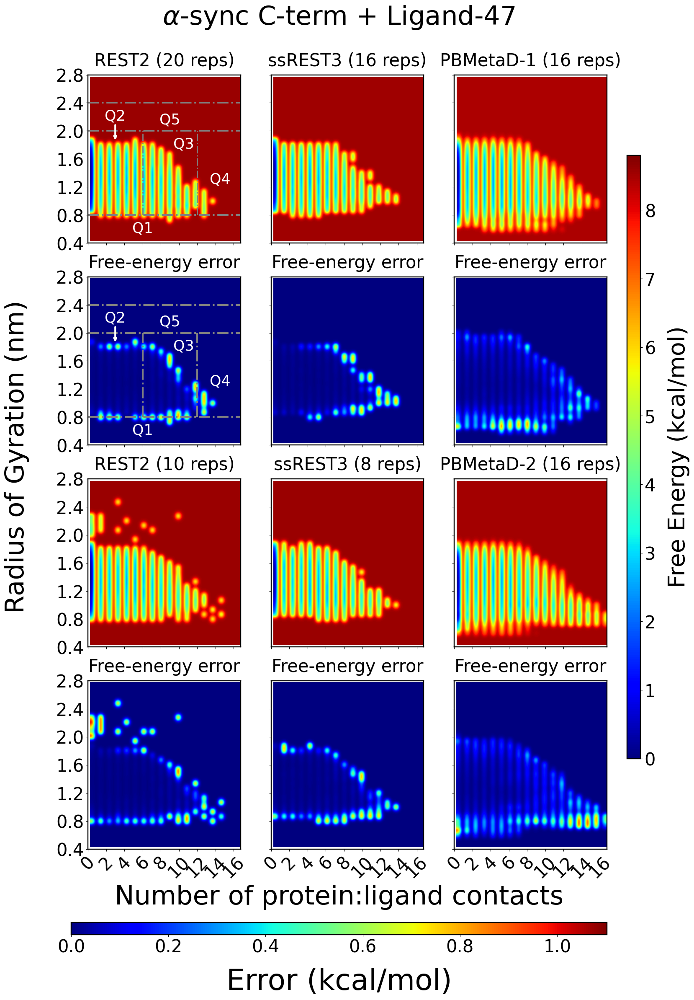

In [63]:
# from mpl_toolkits.axes_grid1 import AxesGrid

fe, xedges,yedges = [],[],[]
bootstrap_results, xcenters, ycenters = [],[],[]

fig, axes = plt.subplots(4,3, figsize=(16,24), sharex=True, sharey=True)

ax = axes.flatten()
# pos = ax[0].get_position()

cax1= fig.add_axes([0.93, 0.2, 0.02, 0.6])
cax2= fig.add_axes([0.1, 0.025, 0.80, 0.012])
     
mybins=35

images1=[]
images2=[]

for i in range(len(data_dir_l)):
    # ax.set_axis_off()

    if i < 4 : 
        Y = rg[i]['rep:0']
        X = np.sum(cm[i]['rep:0'], axis=1)
        f, xe,ye, _  = free_energy_2D(Y=Y, X=X,T=300,bins=35,
                                      y0=0.4, ymax=2.8,x0=0, xmax=17)
        
        args={'X' : np.sum(cm[i]['rep:0'], axis=1),
            'Y' : rg[i]['rep:0'],
            'bin_count' : mybins,
            'y0' : 0.4,
            'ymax' : 2.8,
            'x0' : 0,
            'xmax' : 17}
        
        boot_re, xc, yc = blocking_bootstrap_2d_fe(**args)

        fe.append(f)
        xedges.append(xe)
        yedges.append(ye)
        bootstrap_results.append(boot_re)
        xcenters.append(xc)
        ycenters.append(yc)


    else :
        Y = colvar[f'combined_{i-3}'].T[1]
        X = np.sum(cm[i]['0'], axis=1)
    
        f, xe,ye, _  = free_energy_2D(Y=Y, X=X,
                                                            T=300,bins=35, 
                                                            y0=0.4, ymax=2.8, 
                                                            x0=0, xmax=17, weights=weights_norm[f'combined_{i-3}'])

        args={'X' : np.sum(cm[i]['0'], axis=1),
            'Y' : colvar[f'combined_{i-3}'].T[1],
            'bin_count' : mybins,
            'y0' : 0.4,
            'ymax' : 2.8,
            'x0' : 0,
            'xmax' : 17,
            'weights' : weights_norm[f'combined_{i-3}'],}
        
        boot_re, xc, yc = blocking_bootstrap_2d_fe(**args)

        fe.append(f)
        xedges.append(xe)
        yedges.append(ye)
        bootstrap_results.append(boot_re)
        xcenters.append(xc)
        ycenters.append(yc)

    # p,q = np.unravel_index(i,(4,3))

    # print(p,q)

ax_list_fe={0:0,1:6,2:1,3:7,4:2,5:8}
ax_list_err={0:3,1:9,2:4,3:10,4:5,5:11}

for i in range(len(data_dir_l)) :

    im1 = ax[ax_list_fe[i]].imshow(fe[i], cmap='jet', aspect='auto',
                        extent=[yedges[i][0], yedges[i][-1], xedges[i][0], xedges[i][-1]],
                        interpolation='gaussian', vmin=0, vmax=8.8)
    images1.append(im1)
# for i in range(len(data_dir_l)): 

    im2 = ax[ax_list_err[i]].imshow(np.flipud(bootstrap_results[i].standard_error.reshape(35,35)), cmap='jet', aspect='auto',
                        extent=[ycenters[i][0], ycenters[i][-1], xcenters[i][0], xcenters[i][-1]],
                        interpolation='gaussian')    
    images2.append(im2)
# axes[p,q].invert_yaxis()
    ax[ax_list_fe[i]].set_xticks(np.arange(0, 17, 2), np.arange(0, 17, 2), rotation=0, size=30)
    ax[ax_list_fe[i]].set_yticks(np.arange(0.4, 3.0, 0.4), [round(i, 1) for i in np.arange(0.4, 3.0, 0.4)], rotation=0, size=30)
    ax[ax_list_fe[i]].grid(False)
    ax[ax_list_fe[i]].set_title(title_[i],size=30, pad=15)

    ax[ax_list_err[i]].set_xticks(np.arange(0, 17, 2), np.arange(0, 17, 2), rotation=45, size=30)
    ax[ax_list_err[i]].set_yticks(np.arange(0.4, 3.0, 0.4), [round(i, 1) for i in np.arange(0.4, 3.0, 0.4)], rotation=0, size=30)
    ax[ax_list_err[i]].grid(False)
    ax[ax_list_err[i]].set_title("Free-energy error",size=30, pad=15)

    if i==0:
        ax[ax_list_fe[i]].axhline(y=0.8, color='gray', lw=3, ls='-.')
        # axes.axhline(y=0.4, color='gray', lw=3, ls='-.')
        ax[ax_list_fe[i]].axhline(y=2.0, color='gray', lw=3, ls='-.')
        ax[ax_list_fe[i]].axhline(y=2.4, color='gray', lw=3, ls='-.')
        ax[ax_list_fe[i]].vlines([6,12], 0.8, 2.0, color='gray', lw=2, ls='-.')

        ax[ax_list_err[i]].axhline(y=0.8, color='gray', lw=3, ls='-.')
        # axes.axhline(y=0.4, color='gray', lw=3, ls='-.')
        ax[ax_list_err[i]].axhline(y=2.0, color='gray', lw=3, ls='-.')
        ax[ax_list_err[i]].axhline(y=2.4, color='gray', lw=3, ls='-.')
        ax[ax_list_err[i]].vlines([6,12], 0.8, 2.0, color='gray', lw=3, ls='-.')
# if not q : axes[p,q].set_ylabel("Residues", size=45, labelpad=15)
# if p == 2-1 : axes[p,q].set_xlabel('Residues', size=45, labelpad=15)

        ax[ax_list_err[i]].text(6,0.55, "Q1", ha="center", fontsize=25, color='white')
        # ax[ax_list_err[i]].text(3,1.25, "Q2", ha="center", fontsize=25, color='white')
        ax[ax_list_err[i]].text(3,2.15, "Q2", ha="center", fontsize=25, color='white')

        ax[ax_list_err[i]].text(10.5,1.75, "Q3", ha="center", fontsize=25, color='white')
        ax[ax_list_err[i]].text(14.5,1.25, "Q4", ha="center", fontsize=25, color='white')
        ax[ax_list_err[i]].text(9,2.1, "Q5", ha="center", fontsize=25, color='white')

        ax[ax_list_fe[i]].text(6,0.55, "Q1", ha="center", fontsize=25, color='white')
        # ax[ax_list_fe[i]].text(3,1.25, "Q2", ha="center", fontsize=25, color='black')
        ax[ax_list_fe[i]].text(3,2.15, "Q2", ha="center", fontsize=25, color='white')

        ax[ax_list_fe[i]].text(10.5,1.75, "Q3", ha="center", fontsize=25, color='white')
        ax[ax_list_fe[i]].text(14.5,1.25, "Q4", ha="center", fontsize=25, color='white')
        ax[ax_list_fe[i]].text(9,2.1, "Q5", ha="center", fontsize=25, color='white')

        ax[ax_list_fe[i]].annotate('',xy=(3,1.85),xytext=(3,2.1),arrowprops=dict(arrowstyle="->", lw=3,color='white'))
        ax[ax_list_err[i]].annotate('',xy=(3,1.85),xytext=(3,2.1),arrowprops=dict(arrowstyle="->", lw=3,color='white'))

for ax in axes.flat :

    if not bool(ax.has_data()):

        fig.delaxes(ax)

cbar2 = fig.colorbar(images2[-1],cax=cax2, orientation="horizontal")
cbar1 = fig.colorbar(images1[-1],cax=cax1)

cbar1.set_label("Free Energy (kcal/mol)", size=40, labelpad=20)
cbar1.ax.tick_params(labelsize=30)

cbar2.set_label("Error (kcal/mol)", size=50, labelpad=20)
cbar2.ax.tick_params(labelsize=30)
# cbar.set_ticks([])
# cbar.set_ticklabels([])

fig.text(0.5, 0.055, "Number of protein:ligand contacts", ha="center", fontsize=45)
fig.text(-0.00, 0.5, "Radius of Gyration (nm)", va="center", rotation="vertical", fontsize=45)

# plt.suptitle("Protein:protien contact matix",size=50 )
fig.text(0.5, 0.93, r'$\alpha$-sync C-term + Ligand-47', ha="center", fontsize=45)

# plt.grid(alpha=0.1)
# plt.tight_layout()
plt.savefig(f"{out_dir}/rg_vs_lc_lig47.png", dpi=1000, bbox_inches='tight')
plt.savefig(f"{out_dir}/rg_vs_lc_lig47.pdf", dpi=1000, bbox_inches='tight')
# plt.savefig(f"{out_dir}/p_cm.eps", dpi=1200, bbox_inches='tight')

# plt.show()
# plt.clf()


In [64]:
# def fe_regions(x, y):
#     return np.stack([
#         (x >= 0.8) & (x <= 2.0) & (y >= 0) & (y < 6),
#         (x >= 0.8) & (x <= 2.0) & (y >= 6) & (y < 12),
#         (x >= 0.8) & (x <= 2.0) & (y >= 12) & (y <= 18),
#         (x >= 0.5) & (x <  0.8) & (y >= 0) & (y <= 18),
#         (x >= 2.5) & (x <= 2.9) & (y >= 0) & (y <= 18)
        
#     ]).astype(int)

def fe_regions(x, y):
    return np.stack([
        (x >= 0.4) & (x <  0.8) & (y >= 0) & (y <= 18),
        (x >= 0.8) & (x <= 2.0) & (y >= 0) & (y < 6),
        (x >= 0.8) & (x <= 2.0) & (y >= 6) & (y < 12),
        (x >= 0.8) & (x <= 2.0) & (y >= 12) & (y <= 18),
        (x > 2.0) & (x <= 2.4) & (y >= 0) & (y <= 18)
        
    ]).astype(int)

In [65]:
quad_in=[]

for i in range(len(data_dir_l)):

    if i < 4 :
      
        Y=np.array(rg[i]['rep:0'])
        X=np.sum(cm[i]['rep:0'], axis=1)

        quad_in.append(fe_regions(x=Y, y=X))
    else:

        Y=np.array(colvar[f'combined_{i-3}'].T[1])
        X=np.sum(cm[i]['0'], axis=1)

        quad_in.append(fe_regions(x=Y, y=X))
# quad_in=np.array(quad_in, dtype=object)

In [66]:
q_bootstrap=np.zeros((len(quad_in), len(quad_in[0]), 2)) # (9, 5, 2)

def w_mean(x=None,w=None):
    if w is None : m = np.mean(x)
    else : m = np.dot(x,w)

    return m

for i in range(len(quad_in)):
    for j in range(len(quad_in[i])):

        if i<4:
                
            q_boot=bootstrap((quad_in[i][j],), w_mean, n_resamples=2000, method='percentile')
        else : 

            # q_boot=bootstrap((quad_in[i][j],weights_norm[f'combined_{i-3}']), w_mean, n_resamples=2000, method='percentile')
            continue

        q_bootstrap[i,j,0] = round(q_boot.bootstrap_distribution.mean(), 4)  # mean of the bootstrap distribution
        q_bootstrap[i,j,1] = round(q_boot.standard_error, 4)  # standard error of the bootstrap distribution
        # q_bootstrap[i,j,1] = np.std(quad_in[i][j], ddof=1) / np.sqrt(len(quad_in[i][j]))



In [67]:
q_in_lig47=np.load('/data/ssREST3/q_bootstrap_lig47.npy')
q_bootstrap[4]=q_in_lig47[0]
q_bootstrap[5]=q_in_lig47[1]


In [68]:
import pandas as pd

df = pd.DataFrame(q_bootstrap[:, :, 0], columns=['Q1', 'Q2', 'Q3', 'Q4', 'Q5'])
df.insert(0, 'Simulation', [f"{v}" for k,v in title_.items()])

df.insert(2, 'Q1 err', [f"{t:.4f}" for t in q_bootstrap.T[1][0]])
df.insert(4, 'Q2 err', [f"{t:.4f}" for t in q_bootstrap.T[1][1]])
df.insert(6, 'Q3 err', [f"{t:.4f}" for t in q_bootstrap.T[1][2]])
df.insert(8, 'Q4 err', [f"{t:.4f}" for t in q_bootstrap.T[1][3]])
df.insert(10, 'Q5 err', [f"{t:.4f}" for t in q_bootstrap.T[1][4]])


In [69]:
itables.show(df, classes="display nowrap cell-border")

In [70]:
q_bootstrap_pyblk=np.zeros((len(quad_in), len(quad_in[0]), 2)) # (9, 5, 2)

for i in range(len(quad_in)):
    for j in range(len(quad_in[i])):

        if i<4:
                
            q_boot_mean , q_boot_er = get_blockerror_pyblock_nanskip(np.array(quad_in[i][j]))
        else : 

            q_boot_mean , q_boot_er = get_blockerror_pyblock_nanskip_rw_(np.array(quad_in[i][j]), np.array(weights_norm[f'combined_{i-3}']))

        q_bootstrap_pyblk[i,j,0] = q_boot_mean  # mean of the bootstrap distribution
        q_bootstrap_pyblk[i,j,1] = q_boot_er  # standard error of the bootstrap distribution
        # q_bootstrap_pyblk[i,j,1] = np.std(np.array(quad_in[i][j]), ddof=1) / np.sqrt(len(np.array(quad_in[i][j])))



In [71]:
import pandas as pd

df = pd.DataFrame(q_bootstrap_pyblk[:, :, 0], columns=['Q1', 'Q2', 'Q3', 'Q4', 'Q5'])
df.insert(0, 'Simulation', [f"{v}" for k,v in title_.items()])

df.insert(2, 'Q1 err', [f"{t:.4f}" for t in q_bootstrap_pyblk.T[1][0]])
df.insert(4, 'Q2 err', [f"{t:.4f}" for t in q_bootstrap_pyblk.T[1][1]])
df.insert(6, 'Q3 err', [f"{t:.4f}" for t in q_bootstrap_pyblk.T[1][2]])
df.insert(8, 'Q4 err', [f"{t:.4f}" for t in q_bootstrap_pyblk.T[1][3]])
df.insert(10, 'Q5 err', [f"{t:.4f}" for t in q_bootstrap_pyblk.T[1][4]])


In [72]:
itables.show(df, classes="display nowrap cell-border")


## Fasudil

In [75]:
rg={}

p=0
for i in data_dir_f[:-2]:
    
    rg[p]=json.load(open(i+'rg.json','r'))
    
    p+=1

In [76]:
print('Meta-Dynamics Weights')
weights_norm={}
colvar={}

file_1=f'{meta_dir}/fas_1/colvar/colvar_0.dat'
file_2=f'{meta_dir}/fas_2/colvar/colvar_0.dat'

num_cvs_1, weights_1, weights_norm['combined_1'] = norm_weights(file_1)
num_cvs_2, weights_2, weights_norm['combined_2'] = norm_weights(file_2)

print("No of CV's :", (num_cvs_1-1,num_cvs_2-1))
print(f"Sum of combined xtc : {np.sum(weights_norm['combined_1'])} , {np.sum(weights_norm['combined_2'])}")

colvar['combined_1']=np.loadtxt(file_1,comments=['@','#'])
colvar['combined_2']=np.loadtxt(file_2,comments=['@','#'])

Meta-Dynamics Weights
No of CV's : (12, 12)
Sum of combined xtc : 1.0 , 1.0000000000000004


In [77]:
cm={}

p=0
for i in data_dir_f:
    
    cm[p]=json.load(open(i+'contact_matrix.json','r'))
    
    p+=1

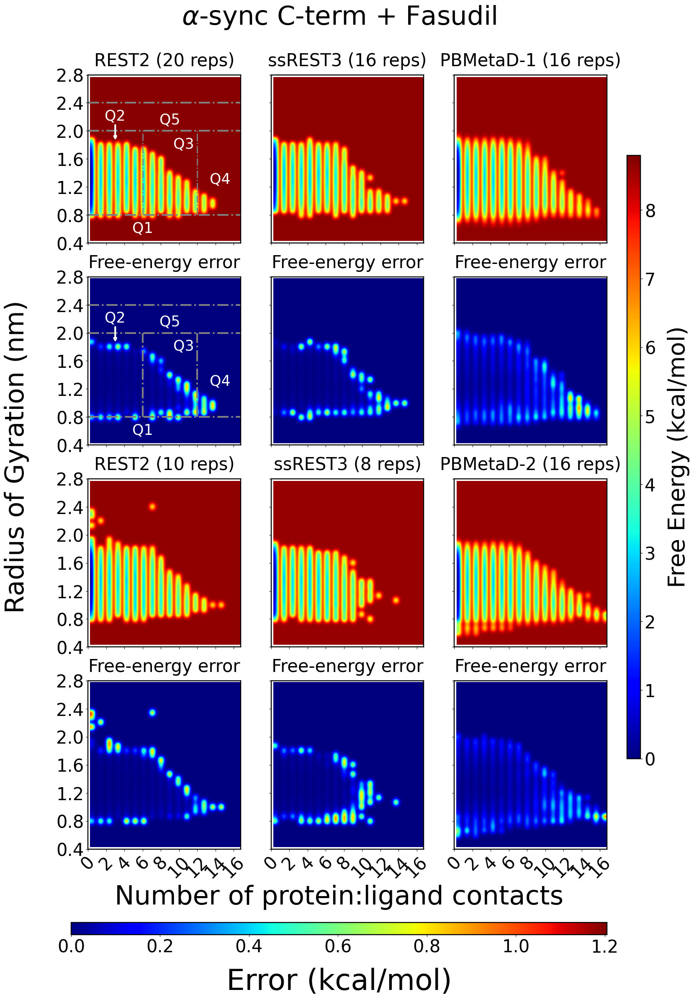

In [79]:
# from mpl_toolkits.axes_grid1 import AxesGrid

fe, xedges,yedges = [],[],[]
bootstrap_results, xcenters, ycenters = [],[],[]

fig, axes = plt.subplots(4,3, figsize=(16,24), sharex=True, sharey=True)

ax = axes.flatten()
# pos = ax[0].get_position()

cax1= fig.add_axes([0.93, 0.2, 0.02, 0.6])
cax2= fig.add_axes([0.1, 0.025, 0.80, 0.012])
     
mybins=35

images1=[]
images2=[]

for i in range(len(data_dir_l)):
    # ax.set_axis_off()

    if i < 4 : 
        Y = rg[i]['rep:0']
        X = np.sum(cm[i]['rep:0'], axis=1)
        f, xe,ye, _  = free_energy_2D(Y=Y, X=X,T=300,bins=35,
                                      y0=0.4, ymax=2.8,x0=0, xmax=17)
        
        args={'X' : np.sum(cm[i]['rep:0'], axis=1),
            'Y' : rg[i]['rep:0'],
            'bin_count' : mybins,
            'y0' : 0.4,
            'ymax' : 2.8,
            'x0' : 0,
            'xmax' : 17}
        
        boot_re, xc, yc = blocking_bootstrap_2d_fe(**args)

        fe.append(f)
        xedges.append(xe)
        yedges.append(ye)
        bootstrap_results.append(boot_re)
        xcenters.append(xc)
        ycenters.append(yc)


    else :
        Y = colvar[f'combined_{i-3}'].T[1]
        X = np.sum(cm[i]['0'], axis=1)
    
        f, xe,ye, _  = free_energy_2D(Y=Y, X=X,
                                                            T=300,bins=35, 
                                                            y0=0.4, ymax=2.8, 
                                                            x0=0, xmax=17, weights=weights_norm[f'combined_{i-3}'])

        args={'X' : np.sum(cm[i]['0'], axis=1),
            'Y' : colvar[f'combined_{i-3}'].T[1],
            'bin_count' : mybins,
            'y0' : 0.4,
            'ymax' : 2.8,
            'x0' : 0,
            'xmax' : 17,
            'weights' : weights_norm[f'combined_{i-3}'],}
        
        boot_re, xc, yc = blocking_bootstrap_2d_fe(**args)

        fe.append(f)
        xedges.append(xe)
        yedges.append(ye)
        bootstrap_results.append(boot_re)
        xcenters.append(xc)
        ycenters.append(yc)

    # p,q = np.unravel_index(i,(4,3))

    # print(p,q)

ax_list_fe={0:0,1:6,2:1,3:7,4:2,5:8}
ax_list_err={0:3,1:9,2:4,3:10,4:5,5:11}

for i in range(len(data_dir_l)) :

    im1 = ax[ax_list_fe[i]].imshow(fe[i], cmap='jet', aspect='auto',
                        extent=[yedges[i][0], yedges[i][-1], xedges[i][0], xedges[i][-1]],
                        interpolation='gaussian', vmin=0, vmax=8.8)
    images1.append(im1)
# for i in range(len(data_dir_l)): 

    im2 = ax[ax_list_err[i]].imshow(np.flipud(bootstrap_results[i].standard_error.reshape(35,35)), cmap='jet', aspect='auto',
                        extent=[ycenters[i][0], ycenters[i][-1], xcenters[i][0], xcenters[i][-1]],
                        interpolation='gaussian')    
    images2.append(im2)
# axes[p,q].invert_yaxis()
    ax[ax_list_fe[i]].set_xticks(np.arange(0, 17, 2), np.arange(0, 17, 2), rotation=0, size=30)
    ax[ax_list_fe[i]].set_yticks(np.arange(0.4, 3.0, 0.4), [round(i, 1) for i in np.arange(0.4, 3.0, 0.4)], rotation=0, size=30)
    ax[ax_list_fe[i]].grid(False)
    ax[ax_list_fe[i]].set_title(title_[i],size=30, pad=15)

    ax[ax_list_err[i]].set_xticks(np.arange(0, 17, 2), np.arange(0, 17, 2), rotation=45, size=30)
    ax[ax_list_err[i]].set_yticks(np.arange(0.4, 3.0, 0.4), [round(i, 1) for i in np.arange(0.4, 3.0, 0.4)], rotation=0, size=30)
    ax[ax_list_err[i]].grid(False)
    ax[ax_list_err[i]].set_title("Free-energy error",size=30, pad=15)


    if i==0:
        ax[ax_list_fe[i]].axhline(y=0.8, color='gray', lw=3, ls='-.')
        # axes.axhline(y=0.4, color='gray', lw=3, ls='-.')
        ax[ax_list_fe[i]].axhline(y=2.0, color='gray', lw=3, ls='-.')
        ax[ax_list_fe[i]].axhline(y=2.4, color='gray', lw=3, ls='-.')
        ax[ax_list_fe[i]].vlines([6,12], 0.8, 2.0, color='gray', lw=2, ls='-.')

        ax[ax_list_err[i]].axhline(y=0.8, color='gray', lw=3, ls='-.')
        # axes.axhline(y=0.4, color='gray', lw=3, ls='-.')
        ax[ax_list_err[i]].axhline(y=2.0, color='gray', lw=3, ls='-.')
        ax[ax_list_err[i]].axhline(y=2.4, color='gray', lw=3, ls='-.')
        ax[ax_list_err[i]].vlines([6,12], 0.8, 2.0, color='gray', lw=3, ls='-.')
# if not q : axes[p,q].set_ylabel("Residues", size=45, labelpad=15)
# if p == 2-1 : axes[p,q].set_xlabel('Residues', size=45, labelpad=15)

        ax[ax_list_err[i]].text(6,0.55, "Q1", ha="center", fontsize=25, color='white')
        # ax[ax_list_err[i]].text(3,1.25, "Q2", ha="center", fontsize=25, color='white')
        ax[ax_list_err[i]].text(3,2.15, "Q2", ha="center", fontsize=25, color='white')

        ax[ax_list_err[i]].text(10.5,1.75, "Q3", ha="center", fontsize=25, color='white')
        ax[ax_list_err[i]].text(14.5,1.25, "Q4", ha="center", fontsize=25, color='white')
        ax[ax_list_err[i]].text(9,2.1, "Q5", ha="center", fontsize=25, color='white')

        ax[ax_list_fe[i]].text(6,0.55, "Q1", ha="center", fontsize=25, color='white')
        # ax[ax_list_fe[i]].text(3,1.25, "Q2", ha="center", fontsize=25, color='black')
        ax[ax_list_fe[i]].text(3,2.15, "Q2", ha="center", fontsize=25, color='white')

        ax[ax_list_fe[i]].text(10.5,1.75, "Q3", ha="center", fontsize=25, color='white')
        ax[ax_list_fe[i]].text(14.5,1.25, "Q4", ha="center", fontsize=25, color='white')
        ax[ax_list_fe[i]].text(9,2.1, "Q5", ha="center", fontsize=25, color='white')

        ax[ax_list_fe[i]].annotate('',xy=(3,1.85),xytext=(3,2.1),arrowprops=dict(arrowstyle="->", lw=3,color='white'))
        ax[ax_list_err[i]].annotate('',xy=(3,1.85),xytext=(3,2.1),arrowprops=dict(arrowstyle="->", lw=3,color='white'))

for ax in axes.flat :

    if not bool(ax.has_data()):

        fig.delaxes(ax)

cbar2 = fig.colorbar(images2[-1],cax=cax2, orientation="horizontal")
cbar1 = fig.colorbar(images1[-1],cax=cax1)

cbar1.set_label("Free Energy (kcal/mol)", size=40, labelpad=20)
cbar1.ax.tick_params(labelsize=30)

cbar2.set_label("Error (kcal/mol)", size=50, labelpad=20)
cbar2.ax.tick_params(labelsize=30)
# cbar.set_ticks([])
# cbar.set_ticklabels([])

fig.text(0.5, 0.055, "Number of protein:ligand contacts", ha="center", fontsize=45)
fig.text(-0.00, 0.5, "Radius of Gyration (nm)", va="center", rotation="vertical", fontsize=45)

# plt.suptitle("Protein:protien contact matix",size=50 )
fig.text(0.5, 0.93, r'$\alpha$-sync C-term + Fasudil', ha="center", fontsize=45)


# plt.grid(alpha=0.1)
# plt.tight_layout()
plt.savefig(f"{out_dir}/rg_vs_lc_fas.png", dpi=1000, bbox_inches='tight')
plt.savefig(f"{out_dir}/rg_vs_lc_fas.pdf", dpi=1000, bbox_inches='tight')
# plt.savefig(f"{out_dir}/p_cm.eps", dpi=1200, bbox_inches='tight')

# plt.show()
# plt.clf()


In [80]:
# def fe_regions(x, y):
#     return np.stack([
#         (x >= 0.8) & (x <= 2.0) & (y >= 0) & (y < 6),
#         (x >= 0.8) & (x <= 2.0) & (y >= 6) & (y < 12),
#         (x >= 0.8) & (x <= 2.0) & (y >= 12) & (y <= 18),
#         (x >= 0.5) & (x <  0.8) & (y >= 0) & (y <= 18),
#         (x >= 2.5) & (x <= 2.9) & (y >= 0) & (y <= 18)
        
#     ]).astype(int)

def fe_regions(x, y):
    return np.stack([
        (x >= 0.4) & (x <  0.8) & (y >= 0) & (y <= 18),
        (x >= 0.8) & (x <= 2.0) & (y >= 0) & (y < 6),
        (x >= 0.8) & (x <= 2.0) & (y >= 6) & (y < 12),
        (x >= 0.8) & (x <= 2.0) & (y >= 12) & (y <= 18),
        (x > 2.0) & (x <= 2.4) & (y >= 0) & (y <= 18)
        
    ]).astype(int)

In [81]:
quad_in=[]

for i in range(len(data_dir_l)):

    if i < 4 :
      
        Y=np.array(rg[i]['rep:0'])
        X=np.sum(cm[i]['rep:0'], axis=1)

        quad_in.append(fe_regions(x=Y, y=X))
    else:

        Y=np.array(colvar[f'combined_{i-3}'].T[1])
        X=np.sum(cm[i]['0'], axis=1)

        quad_in.append(fe_regions(x=Y, y=X))
# quad_in=np.array(quad_in, dtype=object)

In [82]:
q_bootstrap=np.zeros((len(quad_in), len(quad_in[0]), 2)) # (9, 5, 2)

def w_mean(x=None,w=None):
    if w is None : m = np.mean(x)
    else : m = np.dot(x,w)

    return m

for i in range(len(quad_in)):
    for j in range(len(quad_in[i])):

        if i<4:
                
            q_boot=bootstrap((quad_in[i][j],), w_mean, n_resamples=2000, method='percentile')
        else : 

            # q_boot=bootstrap((quad_in[i][j],weights_norm[f'combined_{i-3}']), w_mean, n_resamples=2000, method='percentile')
            continue

        q_bootstrap[i,j,0] = round(q_boot.bootstrap_distribution.mean(), 4)  # mean of the bootstrap distribution
        q_bootstrap[i,j,1] = round(q_boot.standard_error, 4)  # standard error of the bootstrap distribution
        # q_bootstrap[i,j,1] = np.std(quad_in[i][j], ddof=1) / np.sqrt(len(quad_in[i][j]))



In [83]:
q_in_fas=np.load('/data/ssREST3/q_bootstrap_fas.npy')
q_bootstrap[4]=q_in_fas[0]
q_bootstrap[5]=q_in_fas[1]


In [84]:
import pandas as pd

df = pd.DataFrame(q_bootstrap[:, :, 0], columns=['Q1', 'Q2', 'Q3', 'Q4', 'Q5'])
df.insert(0, 'Simulation', [f"{v}" for k,v in title_.items()])

df.insert(2, 'Q1 err', [f"{t:.4f}" for t in q_bootstrap.T[1][0]])
df.insert(4, 'Q2 err', [f"{t:.4f}" for t in q_bootstrap.T[1][1]])
df.insert(6, 'Q3 err', [f"{t:.4f}" for t in q_bootstrap.T[1][2]])
df.insert(8, 'Q4 err', [f"{t:.4f}" for t in q_bootstrap.T[1][3]])
df.insert(10, 'Q5 err', [f"{t:.4f}" for t in q_bootstrap.T[1][4]])


In [85]:
itables.show(df, classes="display nowrap cell-border")


In [86]:
q_bootstrap_pyblk=np.zeros((len(quad_in), len(quad_in[0]), 2)) # (9, 5, 2)

for i in range(len(quad_in)):
    for j in range(len(quad_in[i])):

        if i<4:
                
            q_boot_mean , q_boot_er = get_blockerror_pyblock_nanskip(np.array(quad_in[i][j]))
        else : 

            q_boot_mean , q_boot_er = get_blockerror_pyblock_nanskip_rw_(np.array(quad_in[i][j]), np.array(weights_norm[f'combined_{i-3}']))

        q_bootstrap_pyblk[i,j,0] = q_boot_mean  # mean of the bootstrap distribution
        q_bootstrap_pyblk[i,j,1] = q_boot_er  # standard error of the bootstrap distribution
        # q_bootstrap_pyblk[i,j,1] = np.std(np.array(quad_in[i][j]), ddof=1) / np.sqrt(len(np.array(quad_in[i][j])))



In [87]:
import pandas as pd

df = pd.DataFrame(q_bootstrap_pyblk[:, :, 0], columns=['Q1', 'Q2', 'Q3', 'Q4', 'Q5'])
df.insert(0, 'Simulation', [f"{v}" for k,v in title_.items()])

df.insert(2, 'Q1 err', [f"{t:.4f}" for t in q_bootstrap_pyblk.T[1][0]])
df.insert(4, 'Q2 err', [f"{t:.4f}" for t in q_bootstrap_pyblk.T[1][1]])
df.insert(6, 'Q3 err', [f"{t:.4f}" for t in q_bootstrap_pyblk.T[1][2]])
df.insert(8, 'Q4 err', [f"{t:.4f}" for t in q_bootstrap_pyblk.T[1][3]])
df.insert(10, 'Q5 err', [f"{t:.4f}" for t in q_bootstrap_pyblk.T[1][4]])


In [88]:
itables.show(df, classes="display nowrap cell-border")
